In [2]:
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
import torchvision.transforms.functional as F
from torchvision.utils import make_grid
import numpy as np
import matplotlib.pyplot as plt
import scipy
from skimage import data
from IPython.display import Markdown, display
%load_ext autoreload
%autoreload 2

assesment_draw_and_fill = True

# 1. Getting Started with convolution

A convolution is a mathematical operation between two functions $f$ and $g$ which is defined as:

$$
f(t) \ast g(t) = \int_{-\infty}^\infty f(\tau) \cdot g(t-\tau) d\tau
$$

where $t,\tau \in \mathbb{R}^N$. Examples of functions for $N=1$ can be audio signals, while convolution of images are $N=2$.

Convolution can be seen as a form of a expected value of function $f$ per time $t$, over the function $g$, if the integral over $g$ is $1$. In other words, we can see the convolution as a weighted combination of the values of $f$, where weights are given by $g$.

Convolution arises in many domains, and is just, a particular operation that can be used for different things. The convolution operation, for example, arises when computing the joint distribution of the sum of two independent random variables. This joint distribution is given by the convolution of their marginal densities.

A particular interesting property of convolutions is its connection with the fourier transform. Fourier transform allow us to represent functions as linear combinations of functions of different periods. In other words, in the same way we have basis vectors in an $N$ dimensional eucliden space, we could understand functions as vectors of an infinite dimensional spaces, from which we can define a basis made up from functions. Fourier transform decompose a function into a linear combination of these basis functions. The family of basis functions are sums of sines and cosines of different frequencies and periods. It turns out that under some conditions, the convolution of two functions is equal to the multiplication of their Fourier transforms.

One cool thing as seeing functions from their frequency decomposition is that it is quite intuitive to understand. Frequency is how a function varies per time second. In images this means, how many changes do appear in the image. For example the zone of the image corresponding to the sky (which is mainly blue with no variation) will have frequencies close to zero. However and image containing a lot of variations such as for example a bee pannel, will have higher frequencies. We can see the convolution as the process of removing some of these frequencies. So for example if we convolve our imagen $f$ with a function $g$ that removes low frequencies, the resulting image will have borders enhanced, since image borders are the places where things changes and so have a higher frequency. In the same way, if we get an image and convolve it with a kernel that removes high frequencies, the resulting image will be a blurred image, since the detail is contained in the high frequencies.

##### Task

Implement a `get_vis_range` function that for a given matrix representing an image, obtaines the maximum and minimum values, that should be returned.

The structure of the function should be:

```python
def get_vis_range(Z):
    ...
    return Zmax, Zmin
```

In [79]:
if assesment_draw_and_fill:
    code = """```python
def get_vis_range(Z):
    Z_max = ...
    Z_min = ...
    if Z_max != Z_min:
        return ...,...
    else:
        if Z_max > 1.0:
            return Z_max, 0
        elif Z_max < 0.0:
            return 1, Z_max 
        else:
            return 1, 0
```
"""
    display(Markdown(code))

```python
def get_vis_range(Z):
    Z_max = ...
    Z_min = ...
    if Z_max != Z_min:
        return ...,...
    else:
        if Z_max > 1.0:
            return Z_max, 0
        elif Z_max < 0.0:
            return 1, Z_max 
        else:
            return 1, 0
```


In [73]:
def get_vis_range(Z):
    Z_max = Z.max()
    Z_min = Z.min()
    if Z_max != Z_min:
        return Z_max,Z_min
    else:
        if Z_max > 1.0:
            return Z_max, 0
        elif Z_max < 0.0:
            return 1, Z_max 
        else:
            return 1, 0 

### 1.1 Visualizing basis functions

Let's visualize this basis functions for some frequencies. As you can see, no frequency are constant images while high frequency imply variation.

##### Task

Plot the 2 dimensional function

$$
f(x,y) = \cos(2 \pi f_x \cdot x + 2 \pi f_y \cdot y)
$$

as an image, for different frequency values of $f_x$ and $f_y$. Plot the image over a $N$ by $N$ grid, which should take values from $0$ to $1$. I recommend testing the combination of frequencies $0, 5, 10, 20$. This means a total of 16 images with all possible combination pairs.

Use the `get_vis_range` function to obtain the visualization range before visualizing images with imshow.

In [81]:
if assesment_draw_and_fill:
    code = """```python
# Grid for points
N = ...
grid = np.linspace(...,...,...)
X, Y = np.meshgrid(..., ...)

FX = [...]   
FY = [...]

fig, ax = plt.subplots(len(FX), len(FY), figsize = (20,20))

for i,fx in enumerate(FX):
    for j,fy in enumerate(FY):

        # 2 dimensional cosine funciton.
        Z = ...

        Z_max, Z_min = get_vis_range(Z)
        
        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin = ..., vmax = ...)
        ax[i][j].set_title(f"fx {fx} and fy {fy} ")
```
"""
    display(Markdown(code))

```python
# Grid for points
N = ...
grid = np.linspace(...,...,...)
X, Y = np.meshgrid(..., ...)

FX = [...]   
FY = [...]

fig, ax = plt.subplots(len(FX), len(FY), figsize = (20,20))

for i,fx in enumerate(FX):
    for j,fy in enumerate(FY):

        # 2 dimensional cosine funciton.
        Z = ...

        Z_max, Z_min = get_vis_range(Z)
        
        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin = ..., vmax = ...)
        ax[i][j].set_title(f"fx {fx} and fy {fy} ")
```


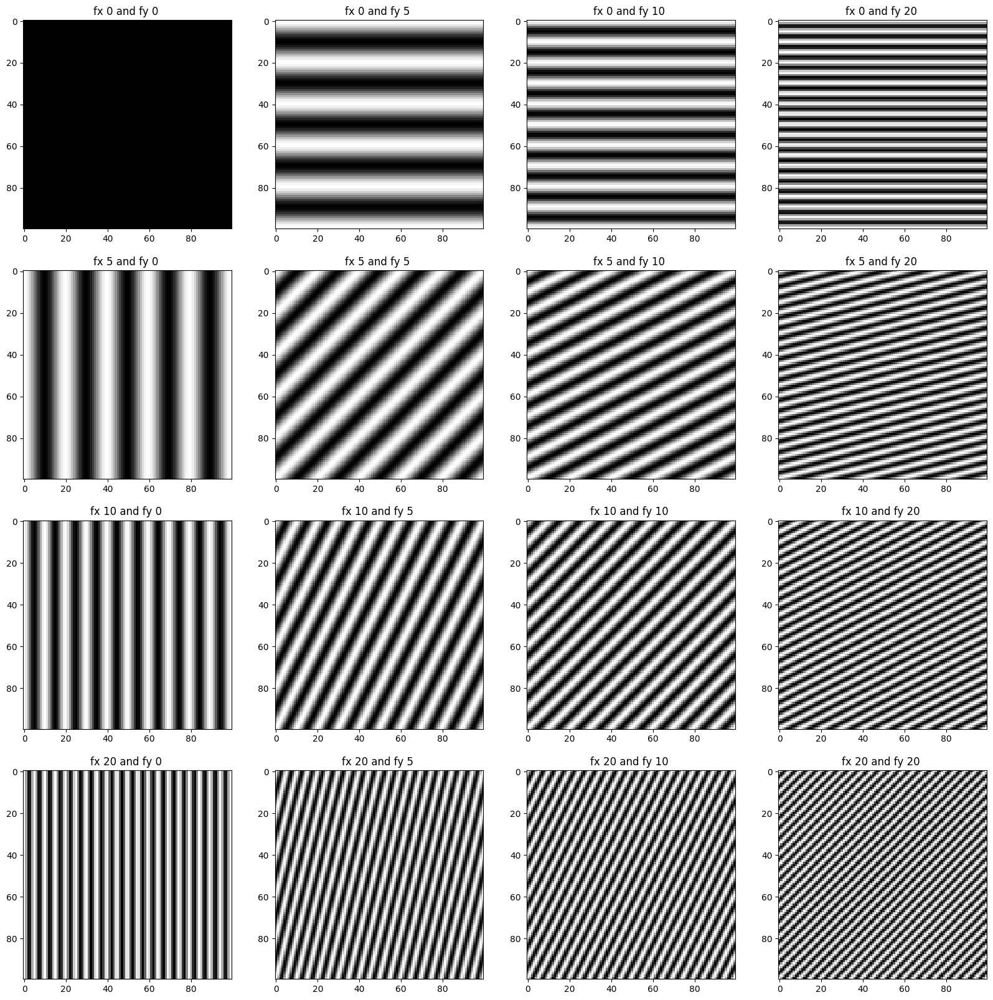

In [71]:
# Grid for points
N = 100
grid = np.linspace(0,1,N)
X, Y = np.meshgrid(grid, grid)

FX = [0, 5, 10, 20]   
FY = [0, 5, 10, 20]

fig, ax = plt.subplots(len(FX), len(FY), figsize = (20,20))

for i,fx in enumerate(FX):
    for j,fy in enumerate(FY):

        # 2 dimensional cosine funciton.
        Z = np.cos(2 * np.pi * fx * X + 2 * np.pi * fy * Y)

        Z_max, Z_min = get_vis_range(Z)
        
        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin = Z_min, vmax = Z_max)
        ax[i][j].set_title(f"fx {fx} and fy {fy} ")

### 1.2 Filtering images

Filtering images is the name given to the convolution of an image with another image (the kernel). Usually, since convolution is a very costly operation (we are not going into the details of it, but it basically stands for slicing an image over each pixel of the other image, multplying all the values and sum them), we approximate the kernel with a smaller image.

Since convolution performs an expected value over each pixel, with density given by the kernel, we can see convolution as combinations of the pixels in the surroundings. This implies that the choice of the kernel will perform different 

#### 1.2.1 Gaussian Filter

The gaussian filter has its name since it is a matrix that approximates a Gaussian distribution. We can have Gaussian filters of many sizes. For example the 5 dimensional Gaussian filter is given by a matrix.


$$
\frac{1}{273}\begin{pmatrix}
1 & 4  & 7  & 4  & 1 \\
4 & 16 & 26 & 16 & 4 \\
7 & 26 & 41 & 26 & 7 \\
4 & 16 & 26 & 16 & 4 \\
1 & 4  & 7  & 4  & 1 \\ 
\end{pmatrix}
$$


What do you think this filter will do? Note that this filter will be centered on each of the pixels of the image. For each pixel, we will multiply the surroundings by the elements of this filter and sum, and so the pixel in the middle will contribute higher to the sum, while as long as we move away the pixels will contribute less. Thus, the effect in the image will be to blurr it, i.e to remove the high frequencies, the details. In other words, it is a low pass filter. Why? Because abrupt changes will be smoothed by the combinations of the pixels in the surroundings. 

##### Task

Filter each of the images in the step above with this Gaussian filter.  You can use the function `scipy.ndimage.convolve`.

You can start from this code to create the grid of images.

```python
# Grid for points
N = 150
grid = np.linspace(0,1,N)
X, Y = np.meshgrid(grid, grid)

FX = [0, 5, 10 , 100]   
FY = [0, 5, 10 , 100]

fig, ax = plt.subplots(len(FX), len(FY), figsize = (20,20))

for i,fx in enumerate(FX):
    for j,fy in enumerate(FY):

        # 2 dimensional cosine funciton.
        Z = np.cos(2 * np.pi * fx * X + 2 * np.pi * fy * Y)

        ## Convolve image
        ...

        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin=-1, vmax=1))
        ax[i][j].set_title(f"fx {fx} and fy {fy} ")

```

In [82]:
if assesment_draw_and_fill:
    code = """```python
# define the kernel
K = ...

# Grid for points
N = ...
grid = np.linspace(...)
X, Y = np.meshgrid(...)

FX = [0, 5, 10, 20]   
FY = [0, 5, 10, 20]

fig, ax = plt.subplots(len(FX), 2*len(FY), figsize = (40,20))

for i,fx in zip(range(0,len(FX)),FX):
    for j,fy in zip(range(0,2*len(FY), 2),FY):

        # 2 dimensional cosine funciton.
        Z = ...

        Z_max, Z_min = get_vis_range(Z)
        
        # Filter it
        F = ...

        F_max, F_min = get_vis_range(F)

        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin=Z_min, vmax=Z_max)
        ax[i][j+1].imshow(F, cmap='gray', vmin=F_min, vmax=F_max)
        ax[i][j].set_title(f"Original fx {fx} and fy {fy} ")
        ax[i][j+1].set_title(f"Filtered fx {fx} and fy {fy} ")
```
"""

    display(Markdown(code))

```python
# define the kernel
K = ...

# Grid for points
N = ...
grid = np.linspace(...)
X, Y = np.meshgrid(...)

FX = [0, 5, 10, 20]   
FY = [0, 5, 10, 20]

fig, ax = plt.subplots(len(FX), 2*len(FY), figsize = (40,20))

for i,fx in zip(range(0,len(FX)),FX):
    for j,fy in zip(range(0,2*len(FY), 2),FY):

        # 2 dimensional cosine funciton.
        Z = ...

        Z_max, Z_min = get_vis_range(Z)
        
        # Filter it
        F = ...

        F_max, F_min = get_vis_range(F)

        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin=Z_min, vmax=Z_max)
        ax[i][j+1].imshow(F, cmap='gray', vmin=F_min, vmax=F_max)
        ax[i][j].set_title(f"Original fx {fx} and fy {fy} ")
        ax[i][j+1].set_title(f"Filtered fx {fx} and fy {fy} ")
```


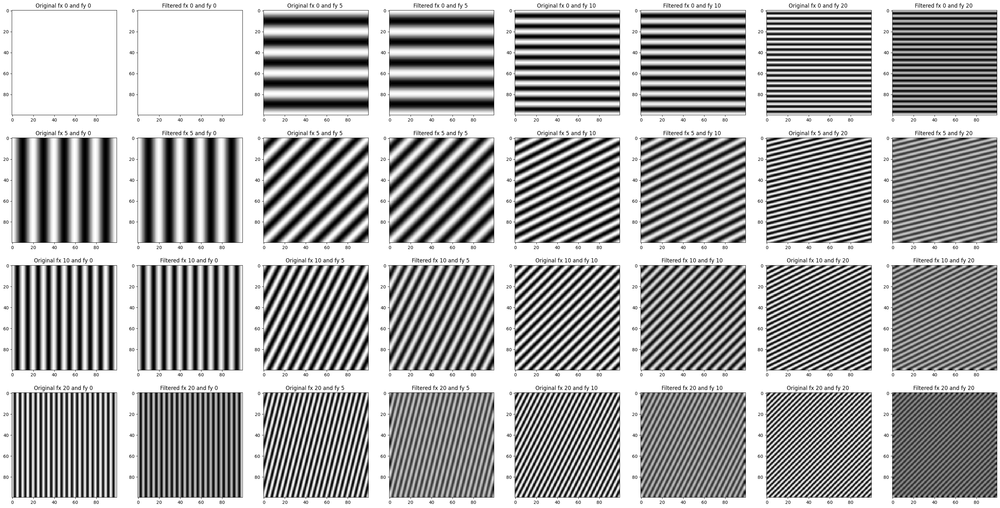

In [100]:
# define the kernel
K = 1/273. * np.array([
    [1, 4,  7,  4,  1],
    [4, 16, 26, 16, 4],
    [7, 26, 41, 26, 7],
    [4, 16, 26, 16, 4],
    [1, 4,  7,  4,  1],
])

# Grid for points
N = 100
grid = np.linspace(0,1,N)
X, Y = np.meshgrid(grid, grid)

FX = [0, 5, 10, 20]   
FY = [0, 5, 10, 20]

fig, ax = plt.subplots(len(FX), 2*len(FY), figsize = (40,20))

for i,fx in zip(range(0,len(FX)),FX):
    for j,fy in zip(range(0,2*len(FY), 2),FY):

        # 2 dimensional cosine funciton.
        Z = np.cos(2 * np.pi * fx * X + 2 * np.pi * fy * Y)

        Z_max, Z_min = get_vis_range(Z)
        
        # Filter it
        F = scipy.ndimage.convolve(Z,K)

        F_max, F_min = get_vis_range(F)

        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin=Z_min, vmax=Z_max)
        ax[i][j+1].imshow(F, cmap='gray', vmin=F_min, vmax=F_max)
        ax[i][j].set_title(f"Original fx {fx} and fy {fy} ")
        ax[i][j+1].set_title(f"Filtered fx {fx} and fy {fy} ")

#### 1.2.1 First Derivative Sobel Filter

In the same way we can design filters that smooth the images, i.e., filter high frequencies out; we can use filters that remove low frequencies, i.e, high frequencies filters. These filters will return the details of the images, i.e. the parts where the images change. Note that a function changing is similar to talking about its gradient, so another way to characterize high pass filters are through gradient operations.

Since images live in $\mathbb{R}^2$ we can compute the derivative w.r.t each of the dimensions. To do so, we can use the Sobel filters, where the filter is given by:

$$
G_x = \begin{pmatrix}
 1 & 0 & -1 \\
 2 & 0 & -2 \\
 1 & 0 & -1  \\
\end{pmatrix}
$$

$$
G_y = \begin{pmatrix}
 1 & 2 & 1 \\
 0 & 0 & 0 \\
-1 & -2 & -1  \\
\end{pmatrix}
$$

##### Task

Filter each of the images with each of these kernels and see differences.

In [85]:
if assesment_draw_and_fill:
    code = """```python
# define the kernel
K = ...

# Grid for points
N = 150
grid = np.linspace(...)
X, Y = np.meshgrid(..., ...)

FX = [0, 5, 10, 20]   
FY = [0, 5, 10, 20]

fig, ax = plt.subplots(len(FX), 2*len(FY), figsize = (40,20))

for i,fx in zip(range(0,len(FX)),FX):
    for j,fy in zip(range(0,2*len(FY), 2),FY):

        # 2 dimensional cosine funciton.
        Z = ...

        Z_max, Z_min = get_vis_range(Z)
        
        # Filter it
        F = ...

        F_max, F_min = get_vis_range(F)
        
        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin=Z_min, vmax=Z_max)
        ax[i][j+1].imshow(F, cmap='gray', vmin=F_min, vmax=F_max)
        ax[i][j].set_title(f"Original fx {fx} and fy {fy} ")
        ax[i][j+1].set_title(f"$G_x$ fx {fx} and fy {fy} ")
```"""
    display(Markdown(code))

```python
# define the kernel
K = ...

# Grid for points
N = 150
grid = np.linspace(...)
X, Y = np.meshgrid(..., ...)

FX = [0, 5, 10, 20]   
FY = [0, 5, 10, 20]

fig, ax = plt.subplots(len(FX), 2*len(FY), figsize = (40,20))

for i,fx in zip(range(0,len(FX)),FX):
    for j,fy in zip(range(0,2*len(FY), 2),FY):

        # 2 dimensional cosine funciton.
        Z = ...

        Z_max, Z_min = get_vis_range(Z)
        
        # Filter it
        F = ...

        F_max, F_min = get_vis_range(F)
        
        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin=Z_min, vmax=Z_max)
        ax[i][j+1].imshow(F, cmap='gray', vmin=F_min, vmax=F_max)
        ax[i][j].set_title(f"Original fx {fx} and fy {fy} ")
        ax[i][j+1].set_title(f"$G_x$ fx {fx} and fy {fy} ")
```

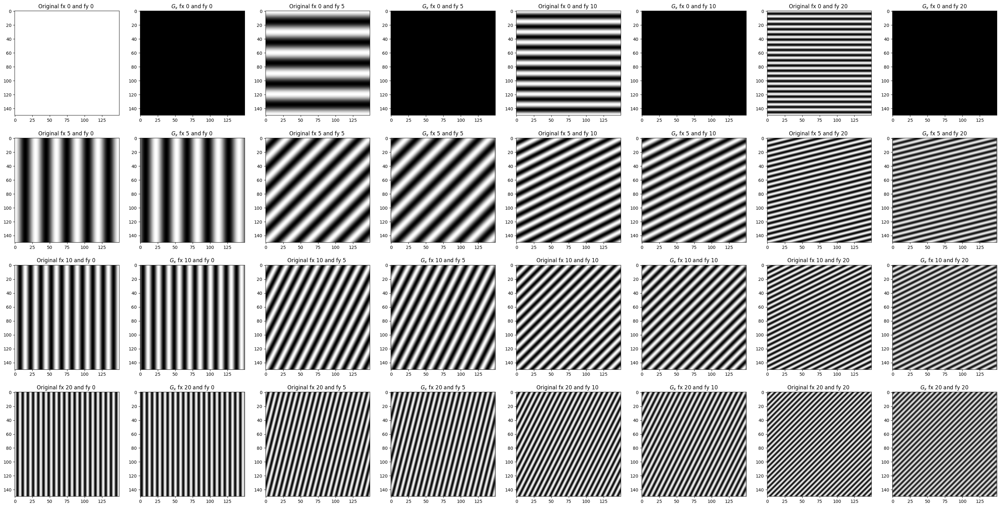

In [112]:
# define the kernel
K = np.array([
    [1, 0, -1],
    [2, 0, -2],
    [1, 0, -1],
])

# Grid for points
N = 150
grid = np.linspace(0,1,N)
X, Y = np.meshgrid(grid, grid)

FX = [0, 5, 10, 20]   
FY = [0, 5, 10, 20]

fig, ax = plt.subplots(len(FX), 2*len(FY), figsize = (40,20))

for i,fx in zip(range(0,len(FX)),FX):
    for j,fy in zip(range(0,2*len(FY), 2),FY):

        # 2 dimensional cosine funciton.
        Z = np.cos(2 * np.pi * fx * X + 2 * np.pi * fy * Y)

        Z_max, Z_min = get_vis_range(Z)
        
        # Filter it
        F = scipy.ndimage.convolve(Z,K)

        F_max, F_min = get_vis_range(F)
        
        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin=Z_min, vmax=Z_max)
        ax[i][j+1].imshow(F, cmap='gray', vmin=F_min, vmax=F_max)
        ax[i][j].set_title(f"Original fx {fx} and fy {fy} ")
        ax[i][j+1].set_title(f"$G_x$ fx {fx} and fy {fy} ")

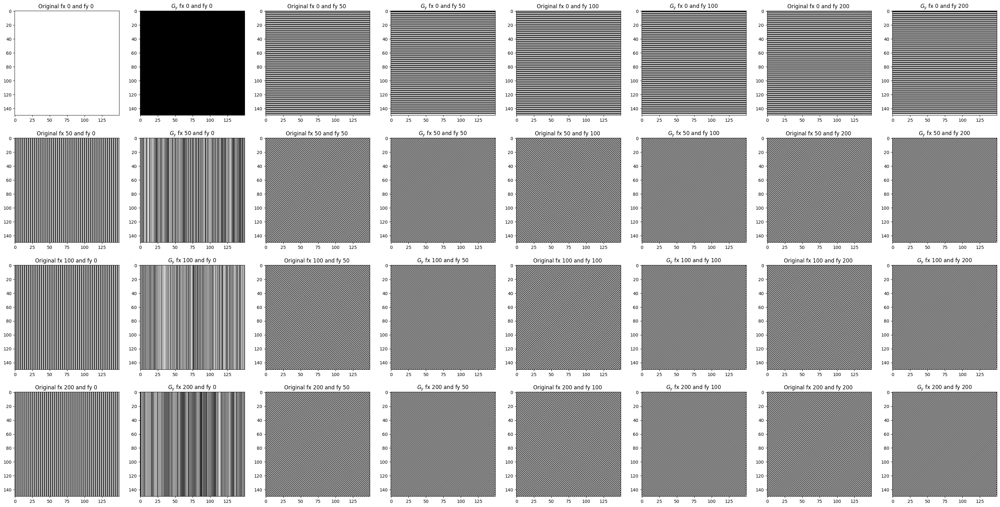

In [114]:
# define the kernel
K = np.array([
    [1, 2, 1],
    [0, 0, 0],
    [-1, -2, -1],
])

# Grid for points
N = 150
grid = np.linspace(0,1,N)
X, Y = np.meshgrid(grid, grid)

FX = [0, 5, 10, 20]   
FY = [0, 5, 10, 20]

fig, ax = plt.subplots(len(FX), 2*len(FY), figsize = (40,20))

for i,fx in zip(range(0,len(FX)),FX):
    for j,fy in zip(range(0,2*len(FY), 2),FY):

        # 2 dimensional cosine funciton.
        Z = np.cos(2 * np.pi * fx * X + 2 * np.pi * fy * Y)

        # normalize image
        Z_max, Z_min = get_vis_range(Z)
        
        # Filter it
        F = scipy.ndimage.convolve(Z,K)

        # normalize image
        F_max, F_min = get_vis_range(F)
        
        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin=Z_min, vmax=Z_max)
        ax[i][j+1].imshow(F, cmap='gray', vmin=F_min, vmax=F_max)
        ax[i][j].set_title(f"Original fx {fx} and fy {fy} ")
        ax[i][j+1].set_title(f"$G_y$ fx {fx} and fy {fy} ")

#### 1.2.2 First derivative (Prewit) Filter

The first derivative of a Gaussian can also be seen as a gradient filter. In this case the kernels are given by:

$$
G_x = \begin{pmatrix}
 1 & 0 & -1 \\
 1 & 0 & -1 \\
 1 & 0 & -1  \\
\end{pmatrix}
$$

$$
G_y = \begin{pmatrix}
 1 & 1 & 1 \\
 0 & 0 & 0 \\
-1 & -1 & -1  \\
\end{pmatrix}
$$

The difference with the Sobel filter is that the Sobel filter also performs a bit of smoothing (i.e low pass filtering).

##### Task

Repeat the experiment with these filters

In [ ]:
if assesment_draw_and_fill:
    code = """```python
# define the kernel
K = ...

# Grid for points
N = 150
grid = np.linspace(...)
X, Y = np.meshgrid(..., ...)

FX = [0, 5, 10, 20]   
FY = [0, 5, 10, 20]

fig, ax = plt.subplots(len(FX), 2*len(FY), figsize = (40,20))

for i,fx in zip(range(0,len(FX)),FX):
    for j,fy in zip(range(0,2*len(FY), 2),FY):

        # 2 dimensional cosine funciton.
        Z = ...

        Z_max, Z_min = get_vis_range(Z)
        
        # Filter it
        F = ...

        F_max, F_min = get_vis_range(F)
        
        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin=Z_min, vmax=Z_max)
        ax[i][j+1].imshow(F, cmap='gray', vmin=F_min, vmax=F_max)
        ax[i][j].set_title(f"Original fx {fx} and fy {fy} ")
        ax[i][j+1].set_title(f"$G_x$ fx {fx} and fy {fy} ")
```"""
    display(Markdown(code))

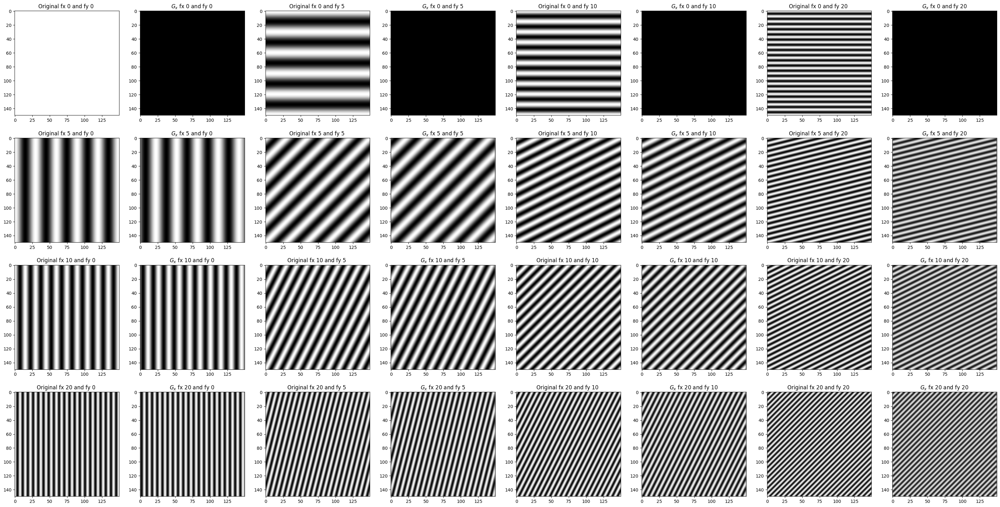

In [121]:
# define the kernel
K = np.array([
    [1, 0, -1],
    [1, 0, -1],
    [1, 0, -1],
])

# Grid for points
N = 150
grid = np.linspace(0,1,N)
X, Y = np.meshgrid(grid, grid)

FX = [0, 5, 10, 20]   
FY = [0, 5, 10, 20]

fig, ax = plt.subplots(len(FX), 2*len(FY), figsize = (40,20))

for i,fx in zip(range(0,len(FX)),FX):
    for j,fy in zip(range(0,2*len(FY), 2),FY):

        # 2 dimensional cosine funciton.
        Z = np.cos(2 * np.pi * fx * X + 2 * np.pi * fy * Y)

        Z_max, Z_min = get_vis_range(Z)
        
        # Filter it
        F = scipy.ndimage.convolve(Z,K)

        F_max, F_min = get_vis_range(F)
        
        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin=Z_min, vmax=Z_max)
        ax[i][j+1].imshow(F, cmap='gray', vmin=F_min, vmax=F_max)
        ax[i][j].set_title(f"Original fx {fx} and fy {fy} ")
        ax[i][j+1].set_title(f"$G_x$ fx {fx} and fy {fy} ")

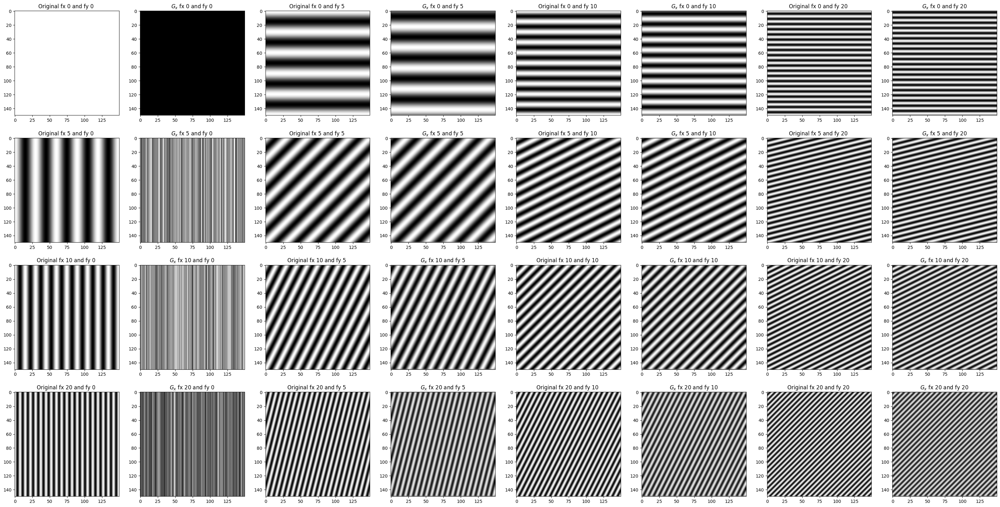

In [116]:
# define the kernel
K = np.transpose(
    np.array([
    [1, 0, -1],
    [1, 0, -1],
    [1, 0, -1],
]))

# Grid for points
N = 150
grid = np.linspace(0,1,N)
X, Y = np.meshgrid(grid, grid)

FX = [0, 5, 10, 20]   
FY = [0, 5, 10, 20]

fig, ax = plt.subplots(len(FX), 2*len(FY), figsize = (40,20))

for i,fx in zip(range(0,len(FX)),FX):
    for j,fy in zip(range(0,2*len(FY), 2),FY):

        # 2 dimensional cosine funciton.
        Z = np.cos(2 * np.pi * fx * X + 2 * np.pi * fy * Y)

        Z_max, Z_min = get_vis_range(Z)
        
        # Filter it
        F = scipy.ndimage.convolve(Z,K)

        F_max, F_min = get_vis_range(F)
        
        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin=Z_min, vmax=Z_max)
        ax[i][j+1].imshow(F, cmap='gray', vmin=F_min, vmax=F_max)
        ax[i][j].set_title(f"Original fx {fx} and fy {fy} ")
        ax[i][j+1].set_title(f"$G_y$ fx {fx} and fy {fy} ")

#### 1.2.3 Second derivative filter aka Laplacian Filter

The laplacian filter is designed to obtain second derivatives. Note that a derivative implies a change in any direction, while a second derivative implies a change in curvature, i.e. going from black, to white and then back to black; while a first derivative filter will detect changes from black to white, no matter if we latter go back to black or keep in white.

$$
\begin{pmatrix}
0 & 1 & 0 \\
1 & -4 & 1 \\
0 & 1 & 0 \\
\end{pmatrix}
$$

##### Task

Apply this filter

In [ ]:
if assesment_draw_and_fill:
    code = """```python
# define the kernel
K = ...

# Grid for points
N = 150
grid = np.linspace(...)
X, Y = np.meshgrid(..., ...)

FX = [0, 5, 10, 20]   
FY = [0, 5, 10, 20]

fig, ax = plt.subplots(len(FX), 2*len(FY), figsize = (40,20))

for i,fx in zip(range(0,len(FX)),FX):
    for j,fy in zip(range(0,2*len(FY), 2),FY):

        # 2 dimensional cosine funciton.
        Z = ...

        Z_max, Z_min = get_vis_range(Z)
        
        # Filter it
        F = ...

        F_max, F_min = get_vis_range(F)
        
        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin=Z_min, vmax=Z_max)
        ax[i][j+1].imshow(F, cmap='gray', vmin=F_min, vmax=F_max)
        ax[i][j].set_title(f"Original fx {fx} and fy {fy} ")
        ax[i][j+1].set_title(f"$G_x$ fx {fx} and fy {fy} ")
```"""
    display(Markdown(code))

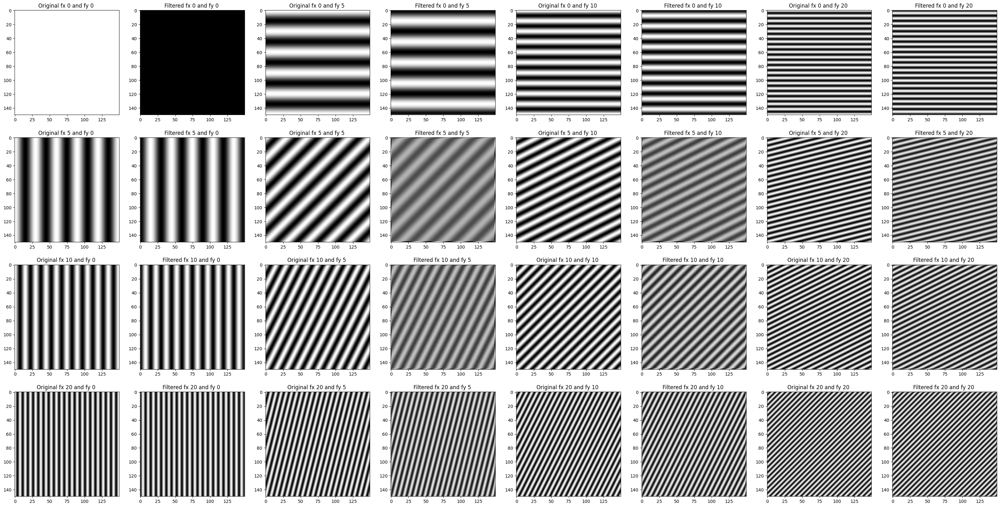

In [124]:
# define the kernel
K =np.array([
    [0, 1, 0],
    [1, -4,1],
    [0, 1, 0],
])

# Grid for points
N = 150
grid = np.linspace(0,1,N)
X, Y = np.meshgrid(grid, grid)

FX = [0, 5, 10, 20]   
FY = [0, 5, 10, 20]

fig, ax = plt.subplots(len(FX), 2*len(FY), figsize = (40,20))

for i,fx in zip(range(0,len(FX)),FX):
    for j,fy in zip(range(0,2*len(FY), 2),FY):

        # 2 dimensional cosine funciton.
        Z = np.cos(2 * np.pi * fx * X + 2 * np.pi * fy * Y)

        Z_max, Z_min = get_vis_range(Z)
        
        # Filter it
        F = scipy.ndimage.convolve(Z,K)

        F_max, F_min = get_vis_range(F)
        
        # show images
        ax[i][j].imshow(Z, cmap='gray', vmin=Z_min, vmax=Z_max)
        ax[i][j+1].imshow(F, cmap='gray', vmin=F_min, vmax=F_max)
        ax[i][j].set_title(f"Original fx {fx} and fy {fy} ")
        ax[i][j+1].set_title(f"Filtered fx {fx} and fy {fy} ")

### 1.3 Filtering Real image


Let's observe the effect of filtering using the three filters on a real imagen. Select whatever image you want for this task. I will use the classical image processing camera, which can be read through:

```python
from skimage import data

im = data.camera()
# convert to dtype float64
im = im.astype(np.float64)
plt.imshow(im, cmap = "gray")
```



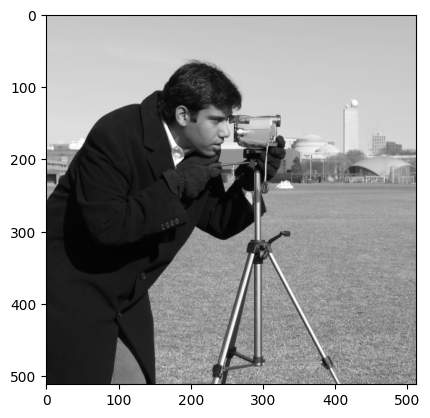

In [92]:
im = data.camera() 
# convert to dtype float64
im = im.astype(np.float64)
plt.imshow(im, cmap = 'gray')

#### 1.3.1 Filter with sobel

In [86]:
if assesment_draw_and_fill:
    code = """```python
K = ...

im_filt = scipy.ndimage.convolve(...)

plt.imshow(im_filt,cmap = 'gray')
```
"""

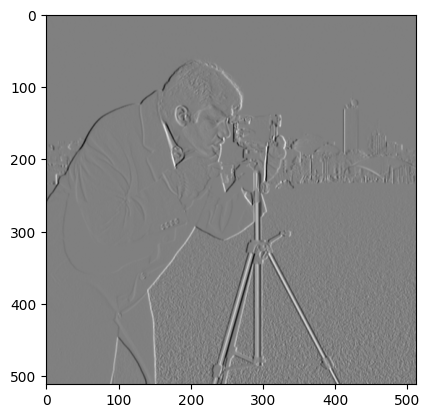

In [153]:
K = np.array([
    [1, 0, -1],
    [2, 0, -2],
    [1, 0, -1],
])

im_filt = scipy.ndimage.convolve(im,K)

plt.imshow(im_filt,cmap = 'gray')

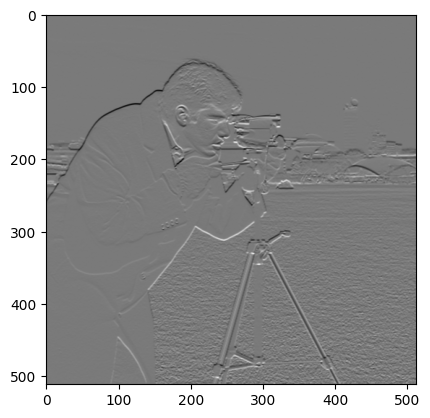

In [154]:
K = np.transpose(np.array([
    [1, 0, -1],
    [2, 0, -2],
    [1, 0, -1],
]))

im_filt = scipy.ndimage.convolve(im,K)

plt.imshow(im_filt,cmap = 'gray')

#### 1.3.2 Filter with Laplace

In [ ]:
if assesment_draw_and_fill:
    code = """```python
K = ...

im_filt = scipy.ndimage.convolve(...)

plt.imshow(im_filt,cmap = 'gray')
```
"""

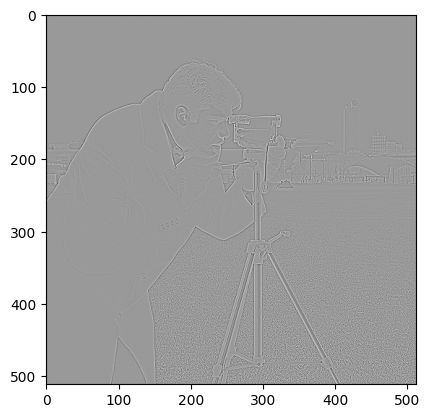

In [155]:
# define the kernel
K =np.array([
    [0, 1, 0],
    [1, -4,1],
    [0, 1, 0],
])

im_filt = scipy.ndimage.convolve(im,K)

plt.imshow(im_filt,cmap = 'gray')

#### 1.3.3 Filter with Gaussian

In [ ]:
if assesment_draw_and_fill:
    code = """```python
K = ...

im_filt = scipy.ndimage.convolve(...)

plt.imshow(im_filt,cmap = 'gray')
```
"""

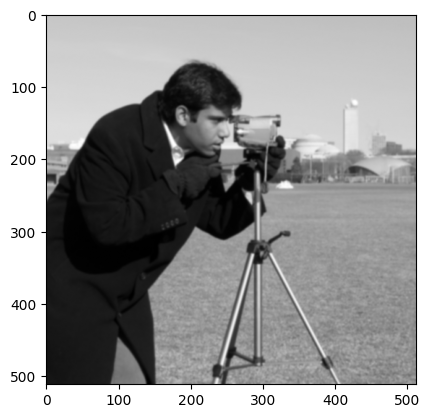

In [156]:
# define the kernel
K = 1/273. * np.array([
    [1, 4,  7,  4,  1],
    [4, 16, 26, 16, 4],
    [7, 26, 41, 26, 7],
    [4, 16, 26, 16, 4],
    [1, 4,  7,  4,  1],
])

im_filt = scipy.ndimage.convolve(im,K)

plt.imshow(im_filt,cmap = 'gray')

#### 1.3.3 Filter with Solber / laplace plus smooth with Gaussian

Since convolution is associative we can chain different convolutions in whatever order to yield a similar result. Moreover, since the result of high pass filtering is very noisy, we can smooth the result by low pass filtering the gradient or second derivatives.


##### Task

Filter the image by first using a laplace and then a gaussian filter. By first using a gaussian and then a laplace filter. Finally filter the image only using a laplace filter. Visualize the three results.

In [90]:
if assesment_draw_and_fill:
    code = """```python
# define the kernel
K_l = ...

K_g = ...

plt.figure()
im_filt = scipy.ndimage.convolve(im,...)
im_filt = scipy.ndimage.convolve(im_filt,...)
plt.imshow(im_filt,cmap = 'gray', vmin = im_filt.min(), vmax = im_filt.max())

plt.figure()
im_filt = scipy.ndimage.convolve(im,...)
im_filt = scipy.ndimage.convolve(im_filt,...)
plt.imshow(im_filt,cmap = 'gray', vmin = im_filt.min(), vmax = im_filt.max())

plt.figure()
im_filt = scipy.ndimage.convolve(im,...)
plt.imshow(im_filt,cmap = 'gray', vmin = im_filt.min(), vmax = im_filt.max())
    
```"""
    display(Markdown(code))

```python
# define the kernel
K_l = ...

K_g = ...

plt.figure()
im_filt = scipy.ndimage.convolve(im,...)
im_filt = scipy.ndimage.convolve(im_filt,...)
plt.imshow(im_filt,cmap = 'gray', vmin = im_filt.min(), vmax = im_filt.max())

plt.figure()
im_filt = scipy.ndimage.convolve(im,...)
im_filt = scipy.ndimage.convolve(im_filt,...)
plt.imshow(im_filt,cmap = 'gray', vmin = im_filt.min(), vmax = im_filt.max())

plt.figure()
im_filt = scipy.ndimage.convolve(im,...)
plt.imshow(im_filt,cmap = 'gray', vmin = im_filt.min(), vmax = im_filt.max())
    
```

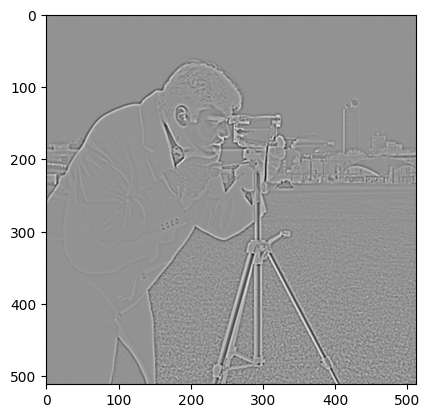

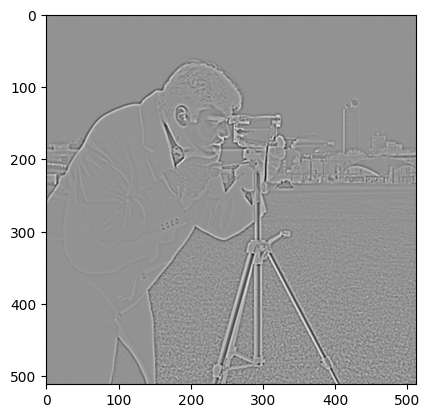

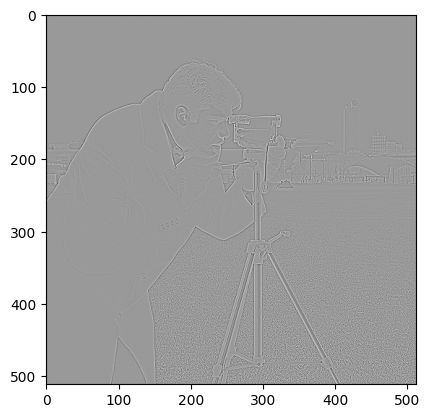

In [161]:
# define the kernel
K_l = np.array([
    [0, 1, 0],
    [1, -4,1],
    [0, 1, 0],
])

K_g = 1/273. * np.array([
    [1, 4,  7,  4,  1],
    [4, 16, 26, 16, 4],
    [7, 26, 41, 26, 7],
    [4, 16, 26, 16, 4],
    [1, 4,  7,  4,  1],
])

plt.figure()
im_filt = scipy.ndimage.convolve(im,K_l)
im_filt = scipy.ndimage.convolve(im_filt,K_g)
plt.imshow(im_filt,cmap = 'gray', vmin = im_filt.min(), vmax = im_filt.max())

plt.figure()
im_filt = scipy.ndimage.convolve(im,K_g)
im_filt = scipy.ndimage.convolve(im_filt,K_l)
plt.imshow(im_filt,cmap = 'gray', vmin = im_filt.min(), vmax = im_filt.max())


plt.figure()
im_filt = scipy.ndimage.convolve(im,K_l)
plt.imshow(im_filt,cmap = 'gray', vmin = im_filt.min(), vmax = im_filt.max())

The effect is better seen by passing in images in uint8 format, since the function rounds internally

Text(0.5, 1.0, 'Only high pass filtering')

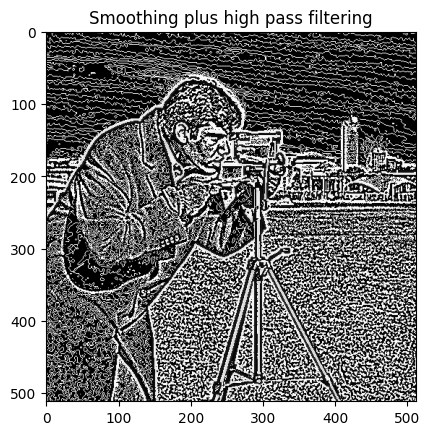

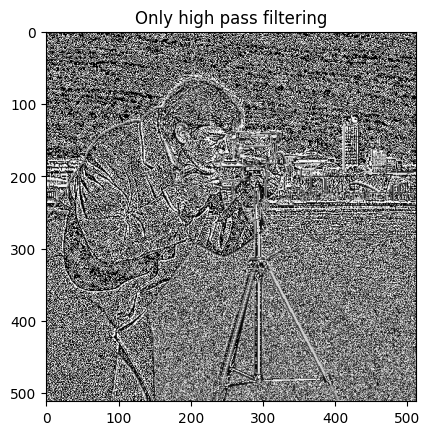

In [93]:
im = im.astype('uint8')

# define the kernel
K_l = np.array([
    [0, 1, 0],
    [1, -4,1],
    [0, 1, 0],
])

K_g = 1/273. * np.array([
    [1, 4,  7,  4,  1],
    [4, 16, 26, 16, 4],
    [7, 26, 41, 26, 7],
    [4, 16, 26, 16, 4],
    [1, 4,  7,  4,  1],
])

plt.figure()
im_filt = scipy.ndimage.convolve(im,K_g)
im_filt = scipy.ndimage.convolve(im_filt,K_l)
plt.imshow(im_filt,cmap = 'gray', vmin = im_filt.min(), vmax = im_filt.max())
plt.title("Smoothing plus high pass filtering")

plt.figure()
im_filt = scipy.ndimage.convolve(im,K_l)
plt.imshow(im_filt,cmap = 'gray', vmin = im_filt.min(), vmax = im_filt.max())
plt.title("Only high pass filtering")

# 2. Convolutional Neural Networks

As you see, the effect of convolving images with a kernel is a usefull way to extract important parts of images that can be used to identify patterns in the image, that we can use to perform some kind of task, such as classification.

But... instead of handcrafting features by specific kernels, what do we do as machine learning practitioners? Learn these kernels (i.e. these feature extractors) using gradient based optimization.

We will see that there are particular nice things we can do with convolutional neural networks to improve their generalization, and we will see that some of the things we have been talking about (such as gradient vanishing) are effects well seen in these networks.

## 2.1 Residual Network 

A residual network is a convolutional neural network that interleaves convolutions, batch normalization, relu and shortcut connections. The structure of a 18 layer Residual Network on the cifar dataset is the following:

All the network uses kernels of 3 by 3 in size.

* input layer adaptation
  * 3 input channels (since CIFAR is RGB)
  * 64 kernel convolution with stride 1, padding 1 and no bias
  * 2d batch normalization
  * activation
* first residual layer
  * 64 kernel convolution with stride 1, padding 1 and no bias
  * 2d batch normalization
  * activation
  * 64 kernel convolution with stride 1, padding 1 and no bias
  * 2d batch normalization
  * residual connection
  * activation
* second residual layer
  * 64 kernel convolution with stride 1, padding 1 and no bias
  * 2d batch normalization
  * activation
  * 64 kernel convolution with stride 1, padding 1 and no bias
  * 2d batch normalization
  * residual connection
  * activation
* third residual layer
  * 128 kernel convolution with stride 2, padding 1 and no bias
  * 2d batch normalization
  * activation
  * 128 kernel convolution with stride 1, padding 1 and no bias
  * 2d batch normalization
  * readaptation layer: kernel size 1, stride 2, 128 filters.
  * residual connection
  * activation
* fourth residual layer
  * 128 kernel convolution with stride 1, padding 1 and no bias
  * 2d batch normalization
  * activation
  * 128 kernel convolution with stride 1, padding 1 and no bias
  * 2d batch normalization
  * residual connection
  * activation
* fifth residual layer
  * 256 kernel convolution with stride 2, padding 1 and no bias
  * 2d batch normalization
  * activation
  * 256 kernel convolution with stride 1, padding 1 and no bias
  * 2d batch normalization
  * readaptation layer: kernel size 1, stride 2, 256 filters.
  * residual connection
  * activation
* sixth residual layer
  * 256 kernel convolution with stride 1, padding 1 and no bias
  * 2d batch normalization
  * activation
  * 256 kernel convolution with stride 1, padding 1 and no bias
  * 2d batch normalization
  * residual connection
  * activation
* seventh residual layer
  * 512 kernel convolution with stride 2, padding 1 and no bias
  * 2d batch normalization
  * activation
  * 512 kernel convolution with stride 1, padding 1 and no bias
  * 2d batch normalization
  * readaptation layer: kernel size 1, stride 2, 512 filters.
  * residual connection
  * activation
* eight residual layer
  * 512 kernel convolution with stride 1, padding 1 and no bias
  * 2d batch normalization
  * activation
  * 512 kernel convolution with stride 1, padding 1 and no bias
  * 2d batch normalization
  * residual connection
  * activation
* average pooling
* linear classification layer

#### Task

How many layers do this network have? Hint: count convolutional operations.

#### Task

Implement and 18 layer residual network. The `nn.Module` should have the following structure:

```python
class ResNet18(nn.Module): 
    def __init__(self, 
            dim_out,
            activation, 
            apply_bn,
            drop_prob,
            link_function, 
            loss_function
        ):
        super(ResNet18, self).__init__()
      
    def operator(self,x):
        ## Implement a forward pass through the computational graph.
        ...
        return x

    def get_feature_maps(self, x):
        ## get feature maps after each layer, and return in a dictionary with key being a layer id.
        ...
        return feature_maps

    def forward_train(self,x, apply_link):
        ## forward through the computational graph in train mode
        ...
        return x

    def forward_eval(self,x, apply_link): 
        ## forward through the computational graph in test mode
        ...
        return x

    def compute_loss(self,t,y):
        ## loss computation
        ...
```

In [94]:
if assesment_draw_and_fill:
    code = """```python
class ResNet18(nn.Module): 
    def __init__(self, 
            dim_out,
            activation, 
            apply_bn,
            drop_prob,
            link_function, 
            loss_function
        ):
        super(ResNet18, self).__init__()
        # Please note that this code can be done efficiently and clearly just by using sequentials and for loops.
        # However in this tutorial I want to make things as clear as possible and thus I use an attribute per layer. 
        # The pipeline of a Resnet-18 is convolution+bn and then 8 resnet blocks of two convolutions changing the 
        # feature map and using stride=2 instead of max pooling. This makes 2*16 + 1 convolution layer-> 17 layer. 
        # And the last fully connected layer 17+1=18 layers. Note that this same module can be used 
        # for cifar100 only changing the value of n_classes

        # activation function
        self.activation = ...

        # whether to apply or not batch normalization
        self.apply_bn = ...

        # dropout
        self.drop = ...
        
        # link and loss functions
        self.link = ...
        self.loss = ...

        ## ===================== ##
        # Input adaptation layer
        self.conv1 = nn.Conv2d(..., ..., kernel_size=..., stride=..., padding=..., bias=False)
        self.bn1 = ...

        ## ===================== ##
        # RESNET BLOCK 1
        self.b1_conv1 = ...
        self.b1_bn1 = ...
        self.b1_conv2 = ...
        self.b1_bn2 = ...

        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        # RESNET BLOCK 2
        self.b2_conv1 = ...
        self.b2_bn1 = ...
        self.b2_conv2 = ...
        self.b2_bn2 = ...
        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        # RESNET BLOCK 3
        self.b3_conv1 = ...
        self.b3_bn1 = ...
        self.b3_conv2 = ...
        self.b3_bn2 = ...

        #resnet connection
        #we need to readapt the input map using 1x1 convolution kernel (like a MLP combining channel dimensions
        self.b3_shortcut_conv= ...
        self.b3_shortcut_bn= ...

        ## ===================== ##
        # RESNET BLOCK 4

        self.b4_conv1 = ...
        self.b4_bn1 = ...
        self.b4_conv2 = ...
        self.b4_bn2 = ...

        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        # RESNET BLOCK 5
        self.b5_conv1 = ...
        self.b5_bn1 = ...
        self.b5_conv2 = ...
        self.b5_bn2 = ...

        #resnet connection
        #we need to readapt the input map using 1x1 convolution kernel (like a MLP combining channel dimensions
        self.b5_shortcut_conv= ...
        self.b5_shortcut_bn= ...

        ## ===================== ##
        # RESNET BLOCK 6

        self.b6_conv1 = ...
        self.b6_bn1 = ...
        self.b6_conv2 = ...
        self.b6_bn2 = ...

        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        # RESNET BLOCK 7
        self.b7_conv1 = ...
        self.b7_bn1 = ...
        self.b7_conv2 = ...
        self.b7_bn2 = ...

        #resnet connection
        #we need to readapt the input map using 1x1 convolution kernel (like a MLP combining channel dimensions
        self.b7_shortcut_conv= ...
        self.b7_shortcut_bn= ...

        ## ===================== ##
        # RESNET BLOCK 8
        self.b8_conv1 = ...
        self.b8_bn1 = ...
        self.b8_conv2 = ...
        self.b8_bn2 = ...
        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        ## Pooling layer

        # the only pooling performed
        self.average_pooling = nn.AvgPool2d(4)

        # To connect to the number of classes
        self.Linear=nn.Linear(512,...)

    def operator(self,x):

        # input adaptation 
        x = ...
        if self.apply_bn:
            x = ...
        x = ...
        
        ## ================== ##
        ## first resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = s...
        x = ... # resnet connection plus activation

        ## =================== ##
        ## second resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = ... 
        x = ... # resnet connection plus activation

        ## ================== ##
        ## third resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = ...
        # we need to readapt the number of maps of the input so it matches the output
        input_readapted = ...
        if self.apply_bn:
            input_readapted = ... 
        x = ... # resnet connection plus activation

        ## =================== ##
        ## fourth resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x = ... # resnet connection plus activation

        ## ================== ##
        ## fifth resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = ...
        # we need to readapt the number of maps of the input so it matches the output
        input_readapted = ...
        if self.apply_bn:
            input_readapted = ... 
        x = ... # resnet connection plus activation

        ## ================== ##
        ## sixth resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = ...   
        x = ... # resnet connection plus activation

        ## ==================== ##
        ## seventh resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = ... 
        # we need to readapt the number of maps of the input so it matches the output
        input_readapted = ...
        if self.apply_bn:
            input_readapted = ... 
        x = ... # resnet connection plus activation

        ## ================== ##
        ## eigth resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = ... 
        x = ... # resnet connection plus activation

        # pooling
        x = self.average_pooling(...)

        # classification
        x = self.Linear(x.view(x.size(0),-1))

        return x

    def get_feature_maps(self, x):
        ...

        ## to save feat_maps
        feature_maps = {}

        # input adaptation 
        ...

        feature_maps['layer1'] = x.clone()

        ## ================== ##
        ## first resnet block ##
        ...

        feature_maps['layer2'] = x.clone()

        ## =================== ##
        ## second resnet block ##
        ...

        feature_maps['layer3'] = x.clone()
        
        ## ================== ##
        ## third resnet block ##
        ...

        feature_maps['layer4'] = x.clone()
        
        ## =================== ##
        ## fourth resnet block ##
        ...

        feature_maps['layer5'] = x.clone()
        
        ## ================== ##
        ## fifth resnet block ##
        ...

        feature_maps['layer6'] = x.clone()
        
        ## ================== ##
        ## sixth resnet block ##
        ...

        feature_maps['layer7'] = x.clone()
        
        ## ==================== ##
        ## seventh resnet block ##https://www.sagacify.com/news/a-guide-to-chunking-strategies-for-retrieval-augmented-generation-rag
        ...

        feature_maps['layer8'] = x.clone()
        
        ## ================== ##
        ## eigth resnet block ##
        ...

        feature_maps['layer9'] = x.clone()
        
        # pooling
        x = self.average_pooling(x)

        feature_maps['layer_pooling'] = x.clone()
        
        return ...

    def forward_train(self,x, apply_link):
        ...
        x = ...
        if apply_link:
            x = ...
        return x

    def forward_eval(self,x, apply_link): 
        ...
        x = ...
        if apply_link:
            x = ...
        return x

    def compute_loss(self,t,y):
        return ...
```"""
    display(Markdown(code))

```python
class ResNet18(nn.Module): 
    def __init__(self, 
            dim_out,
            activation, 
            apply_bn,
            drop_prob,
            link_function, 
            loss_function
        ):
        super(ResNet18, self).__init__()
        # Please note that this code can be done efficiently and clearly just by using sequentials and for loops.
        # However in this tutorial I want to make things as clear as possible and thus I use an attribute per layer. 
        # The pipeline of a Resnet-18 is convolution+bn and then 8 resnet blocks of two convolutions changing the 
        # feature map and using stride=2 instead of max pooling. This makes 2*16 + 1 convolution layer-> 17 layer. 
        # And the last fully connected layer 17+1=18 layers. Note that this same module can be used 
        # for cifar100 only changing the value of n_classes

        # activation function
        self.activation = ...

        # whether to apply or not batch normalization
        self.apply_bn = ...

        # dropout
        self.drop = ...
        
        # link and loss functions
        self.link = ...
        self.loss = ...

        ## ===================== ##
        # Input adaptation layer
        self.conv1 = nn.Conv2d(..., ..., kernel_size=..., stride=..., padding=..., bias=False)
        self.bn1 = ...

        ## ===================== ##
        # RESNET BLOCK 1
        self.b1_conv1 = ...
        self.b1_bn1 = ...
        self.b1_conv2 = ...
        self.b1_bn2 = ...

        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        # RESNET BLOCK 2
        self.b2_conv1 = ...
        self.b2_bn1 = ...
        self.b2_conv2 = ...
        self.b2_bn2 = ...
        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        # RESNET BLOCK 3
        self.b3_conv1 = ...
        self.b3_bn1 = ...
        self.b3_conv2 = ...
        self.b3_bn2 = ...

        #resnet connection
        #we need to readapt the input map using 1x1 convolution kernel (like a MLP combining channel dimensions
        self.b3_shortcut_conv= ...
        self.b3_shortcut_bn= ...

        ## ===================== ##
        # RESNET BLOCK 4

        self.b4_conv1 = ...
        self.b4_bn1 = ...
        self.b4_conv2 = ...
        self.b4_bn2 = ...

        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        # RESNET BLOCK 5
        self.b5_conv1 = ...
        self.b5_bn1 = ...
        self.b5_conv2 = ...
        self.b5_bn2 = ...

        #resnet connection
        #we need to readapt the input map using 1x1 convolution kernel (like a MLP combining channel dimensions
        self.b5_shortcut_conv= ...
        self.b5_shortcut_bn= ...

        ## ===================== ##
        # RESNET BLOCK 6

        self.b6_conv1 = ...
        self.b6_bn1 = ...
        self.b6_conv2 = ...
        self.b6_bn2 = ...

        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        # RESNET BLOCK 7
        self.b7_conv1 = ...
        self.b7_bn1 = ...
        self.b7_conv2 = ...
        self.b7_bn2 = ...

        #resnet connection
        #we need to readapt the input map using 1x1 convolution kernel (like a MLP combining channel dimensions
        self.b7_shortcut_conv= ...
        self.b7_shortcut_bn= ...

        ## ===================== ##
        # RESNET BLOCK 8
        self.b8_conv1 = ...
        self.b8_bn1 = ...
        self.b8_conv2 = ...
        self.b8_bn2 = ...
        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        ## Pooling layer

        # the only pooling performed
        self.average_pooling = nn.AvgPool2d(4)

        # To connect to the number of classes
        self.Linear=nn.Linear(512,...)

    def operator(self,x):

        # input adaptation 
        x = ...
        if self.apply_bn:
            x = ...
        x = ...
        
        ## ================== ##
        ## first resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = s...
        x = ... # resnet connection plus activation

        ## =================== ##
        ## second resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = ... 
        x = ... # resnet connection plus activation

        ## ================== ##
        ## third resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = ...
        # we need to readapt the number of maps of the input so it matches the output
        input_readapted = ...
        if self.apply_bn:
            input_readapted = ... 
        x = ... # resnet connection plus activation

        ## =================== ##
        ## fourth resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x = ... # resnet connection plus activation

        ## ================== ##
        ## fifth resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = ...
        # we need to readapt the number of maps of the input so it matches the output
        input_readapted = ...
        if self.apply_bn:
            input_readapted = ... 
        x = ... # resnet connection plus activation

        ## ================== ##
        ## sixth resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = ...   
        x = ... # resnet connection plus activation

        ## ==================== ##
        ## seventh resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = ... 
        # we need to readapt the number of maps of the input so it matches the output
        input_readapted = ...
        if self.apply_bn:
            input_readapted = ... 
        x = ... # resnet connection plus activation

        ## ================== ##
        ## eigth resnet block ##
        x_block = ...
        if self.apply_bn:
            x_block = ...
        x_block = ...
        if self.apply_bn:
            x_block = ... 
        x = ... # resnet connection plus activation

        # pooling
        x = self.average_pooling(...)

        # classification
        x = self.Linear(x.view(x.size(0),-1))

        return x

    def get_feature_maps(self, x):
        ...

        ## to save feat_maps
        feature_maps = {}

        # input adaptation 
        ...

        feature_maps['layer1'] = x.clone()

        ## ================== ##
        ## first resnet block ##
        ...

        feature_maps['layer2'] = x.clone()

        ## =================== ##
        ## second resnet block ##
        ...

        feature_maps['layer3'] = x.clone()
        
        ## ================== ##
        ## third resnet block ##
        ...

        feature_maps['layer4'] = x.clone()
        
        ## =================== ##
        ## fourth resnet block ##
        ...

        feature_maps['layer5'] = x.clone()
        
        ## ================== ##
        ## fifth resnet block ##
        ...

        feature_maps['layer6'] = x.clone()
        
        ## ================== ##
        ## sixth resnet block ##
        ...

        feature_maps['layer7'] = x.clone()
        
        ## ==================== ##
        ## seventh resnet block ##https://www.sagacify.com/news/a-guide-to-chunking-strategies-for-retrieval-augmented-generation-rag
        ...

        feature_maps['layer8'] = x.clone()
        
        ## ================== ##
        ## eigth resnet block ##
        ...

        feature_maps['layer9'] = x.clone()
        
        # pooling
        x = self.average_pooling(x)

        feature_maps['layer_pooling'] = x.clone()
        
        return ...

    def forward_train(self,x, apply_link):
        ...
        x = ...
        if apply_link:
            x = ...
        return x

    def forward_eval(self,x, apply_link): 
        ...
        x = ...
        if apply_link:
            x = ...
        return x

    def compute_loss(self,t,y):
        return ...
```

In [4]:
class ResNet18(nn.Module): 
    def __init__(self, 
            dim_out,
            activation, 
            apply_bn,
            drop_prob,
            link_function, 
            loss_function
        ):
        super(ResNet18, self).__init__()
        # Please note that this code can be done efficiently and clearly just by using sequentials and for loops.
        # However in this tutorial I want to make things as clear as possible and thus I use an attribute per layer. 
        # The pipeline of a Resnet-18 is convolution+bn and then 8 resnet blocks of two convolutions changing the 
        # feature map and using stride=2 instead of max pooling. This makes 2*16 + 1 convolution layer-> 17 layer. 
        # And the last fully connected layer 17+1=18 layers. Note that this same module can be used 
        # for cifar100 only changing the value of n_classes

        # activation function
        self.activation = activation

        # whether to apply or not batch normalization
        self.apply_bn = apply_bn

        # dropout
        self.drop = nn.Dropout2d(drop_prob)
        
        # link and loss functions
        self.link = link_function
        self.loss = loss_function

        ## ===================== ##
        # Input adaptation layer
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(64)

        ## ===================== ##
        # RESNET BLOCK 1
        self.b1_conv1 = nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1, bias=False)
        self.b1_bn1 = nn.BatchNorm2d(64)
        self.b1_conv2 = nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1, bias=False)
        self.b1_bn2 = nn.BatchNorm2d(64)

        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        # RESNET BLOCK 2
        self.b2_conv1 = nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1, bias=False)
        self.b2_bn1 = nn.BatchNorm2d(64)
        self.b2_conv2 = nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1, bias=False)
        self.b2_bn2 = nn.BatchNorm2d(64)
        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        # RESNET BLOCK 3
        self.b3_conv1 = nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1, bias=False)
        self.b3_bn1 = nn.BatchNorm2d(128)
        self.b3_conv2 = nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1, bias=False)
        self.b3_bn2 = nn.BatchNorm2d(128)

        #resnet connection
        #we need to readapt the input map using 1x1 convolution kernel (like a MLP combining channel dimensions
        self.b3_shortcut_conv= nn.Conv2d(64, 128, kernel_size=1, stride=2, bias=False)
        self.b3_shortcut_bn= nn.BatchNorm2d(128)

        ## ===================== ##
        # RESNET BLOCK 4

        self.b4_conv1 = nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1, bias=False)
        self.b4_bn1 = nn.BatchNorm2d(128)
        self.b4_conv2 = nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1, bias=False)
        self.b4_bn2 = nn.BatchNorm2d(128)

        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        # RESNET BLOCK 5
        self.b5_conv1 = nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1, bias=False)
        self.b5_bn1 = nn.BatchNorm2d(256)
        self.b5_conv2 = nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1, bias=False)
        self.b5_bn2 = nn.BatchNorm2d(256)

        #resnet connection
        #we need to readapt the input map using 1x1 convolution kernel (like a MLP combining channel dimensions
        self.b5_shortcut_conv= nn.Conv2d(128, 256, kernel_size=1, stride=2, bias=False)
        self.b5_shortcut_bn= nn.BatchNorm2d(256)

        ## ===================== ##
        # RESNET BLOCK 6

        self.b6_conv1 = nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1, bias=False)
        self.b6_bn1 = nn.BatchNorm2d(256)
        self.b6_conv2 = nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1, bias=False)
        self.b6_bn2 = nn.BatchNorm2d(256)

        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        # RESNET BLOCK 7
        self.b7_conv1 = nn.Conv2d(256, 512, kernel_size=3, stride=2, padding=1, bias=False)
        self.b7_bn1 = nn.BatchNorm2d(512)
        self.b7_conv2 = nn.Conv2d(512, 512, kernel_size=3, stride=1, padding=1, bias=False)
        self.b7_bn2 = nn.BatchNorm2d(512)

        #resnet connection
        #we need to readapt the input map using 1x1 convolution kernel (like a MLP combining channel dimensions
        self.b7_shortcut_conv= nn.Conv2d(256,512, kernel_size=1, stride=2, bias=False)
        self.b7_shortcut_bn= nn.BatchNorm2d(512)

        ## ===================== ##
        # RESNET BLOCK 8
        self.b8_conv1 = nn.Conv2d(512, 512, kernel_size=3, stride=1, padding=1, bias=False)
        self.b8_bn1 = nn.BatchNorm2d(512)
        self.b8_conv2 = nn.Conv2d(512, 512, kernel_size=3, stride=1, padding=1, bias=False)
        self.b8_bn2 = nn.BatchNorm2d(512)
        #resnet connection
        #no readaptation is needed

        ## ===================== ##
        ## Pooling layer

        # the only pooling performed
        self.average_pooling=nn.AvgPool2d(4)

        # To connect to the number of classes
        self.Linear=nn.Linear(512,dim_out)

    def operator(self,x):

        # input adaptation 
        x = self.conv1(x)
        if self.apply_bn:
            x = self.bn1(x)
        x = self.drop(self.activation(x))

        ## ================== ##
        ## first resnet block ##
        x_block = self.b1_conv1(x)
        if self.apply_bn:
            x_block = self.b1_bn1(x_block)
        x_block = self.b1_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b1_bn2(x_block)     
        x = self.drop(self.activation(x+x_block)) # resnet connection plus activation

        ## =================== ##
        ## second resnet block ##
        x_block = self.b2_conv1(x)
        if self.apply_bn:
            x_block = self.b2_bn1(x_block)
        x_block = self.b2_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b2_bn2(x_block)   
        x = self.drop(self.activation(x+x_block)) # resnet connection plus activation

        ## ================== ##
        ## third resnet block ##
        x_block = self.b3_conv1(x)
        if self.apply_bn:
            x_block = self.b3_bn1(x_block)
        x_block = self.b3_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b3_bn2(x_block)   
        # we need to readapt the number of maps of the input so it matches the output
        input_readapted = self.b3_shortcut_conv(x)
        if self.apply_bn:
            input_readapted = self.b3_shortcut_bn(input_readapted) 
        x = self.drop(self.activation(input_readapted+x_block)) # resnet connection plus activation

        ## =================== ##
        ## fourth resnet block ##
        x_block = self.b4_conv1(x)
        if self.apply_bn:
            x_block = self.b4_bn1(x_block)
        x_block = self.b4_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b4_bn2(x_block)   
        x = self.drop(self.activation(x+x_block)) # resnet connection plus activation

        ## ================== ##
        ## fifth resnet block ##
        x_block = self.b5_conv1(x)
        if self.apply_bn:
            x_block = self.b5_bn1(x_block)
        x_block = self.b5_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b5_bn2(x_block)   
        # we need to readapt the number of maps of the input so it matches the output
        input_readapted = self.b5_shortcut_conv(x)
        if self.apply_bn:
            input_readapted = self.b5_shortcut_bn(input_readapted) 
        x = self.drop(self.activation(input_readapted+x_block)) # resnet connection plus activation

        ## ================== ##
        ## sixth resnet block ##
        x_block = self.b6_conv1(x)
        if self.apply_bn:
            x_block = self.b6_bn1(x_block)
        x_block = self.b6_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b6_bn2(x_block)   
        x = self.drop(self.activation(x+x_block)) # resnet connection plus activation

        ## ==================== ##
        ## seventh resnet block ##
        x_block = self.b7_conv1(x)
        if self.apply_bn:
            x_block = self.b7_bn1(x_block)
        x_block = self.b7_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b7_bn2(x_block)   
        # we need to readapt the number of maps of the input so it matches the output
        input_readapted = self.b7_shortcut_conv(x)
        if self.apply_bn:
            input_readapted = self.b7_shortcut_bn(input_readapted) 
        x = self.drop(self.activation(input_readapted+x_block)) # resnet connection plus activation

        ## ================== ##
        ## eigth resnet block ##
        x_block = self.b8_conv1(x)
        if self.apply_bn:
            x_block = self.b8_bn1(x_block)
        x_block = self.b8_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b8_bn2(x_block)   
        x = self.drop(self.activation(x+x_block)) # resnet connection plus activation

        # pooling
        x = self.average_pooling(x)

        # classification
        x = self.Linear(x.view(x.size(0),-1))

        return x

    def get_feature_maps(self, x):
        self.eval()

        ## to save feat_maps
        feature_maps = {}

        # input adaptation 
        x = self.conv1(x)
        if self.apply_bn:
            x = self.bn1(x)
        x = self.drop(self.activation(x))

        feature_maps['layer1'] = x.clone()

        ## ================== ##
        ## first resnet block ##
        x_block = self.b1_conv1(x)
        if self.apply_bn:
            x_block = self.b1_bn1(x_block)
        x_block = self.b1_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b1_bn2(x_block)     
        x = self.drop(self.activation(x+x_block)) # resnet connection plus activation

        feature_maps['layer2'] = x.clone()

        ## =================== ##
        ## second resnet block ##
        x_block = self.b2_conv1(x)
        if self.apply_bn:
            x_block = self.b2_bn1(x_block)
        x_block = self.b2_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b2_bn2(x_block)   
        x = self.drop(self.activation(x+x_block)) # resnet connection plus activation

        feature_maps['layer3'] = x.clone()
        
        ## ================== ##
        ## third resnet block ##
        x_block = self.b3_conv1(x)
        if self.apply_bn:
            x_block = self.b3_bn1(x_block)
        x_block = self.b3_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b3_bn2(x_block)   
        # we need to readapt the number of maps of the input so it matches the output
        input_readapted = self.b3_shortcut_conv(x)
        if self.apply_bn:
            input_readapted = self.b3_shortcut_bn(input_readapted) 
        x = self.drop(self.activation(input_readapted+x_block)) # resnet connection plus activation

        feature_maps['layer4'] = x.clone()
        
        ## =================== ##
        ## fourth resnet block ##
        x_block = self.b4_conv1(x)
        if self.apply_bn:
            x_block = self.b4_bn1(x_block)
        x_block = self.b4_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b4_bn2(x_block)   
        x = self.drop(self.activation(x+x_block)) # resnet connection plus activation

        feature_maps['layer5'] = x.clone()
        
        ## ================== ##
        ## fifth resnet block ##
        x_block = self.b5_conv1(x)
        if self.apply_bn:
            x_block = self.b5_bn1(x_block)
        x_block = self.b5_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b5_bn2(x_block)   
        # we need to readapt the number of maps of the input so it matches the output
        input_readapted = self.b5_shortcut_conv(x)
        if self.apply_bn:
            input_readapted = self.b5_shortcut_bn(input_readapted) 
        x = self.drop(self.activation(input_readapted+x_block)) # resnet connection plus activation

        feature_maps['layer6'] = x.clone()
        
        ## ================== ##
        ## sixth resnet block ##
        x_block = self.b6_conv1(x)
        if self.apply_bn:
            x_block = self.b6_bn1(x_block)
        x_block = self.b6_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b6_bn2(x_block)   
        x = self.drop(self.activation(x+x_block)) # resnet connection plus activation

        feature_maps['layer7'] = x.clone()
        
        ## ==================== ##
        ## seventh resnet block ##https://www.sagacify.com/news/a-guide-to-chunking-strategies-for-retrieval-augmented-generation-rag
        x_block = self.b7_conv1(x)
        if self.apply_bn:
            x_block = self.b7_bn1(x_block)
        x_block = self.b7_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b7_bn2(x_block)   
        # we need to readapt the number of maps of the input so it matches the output
        input_readapted = self.b7_shortcut_conv(x)
        if self.apply_bn:
            input_readapted = self.b7_shortcut_bn(input_readapted) 
        x = self.drop(self.activation(input_readapted+x_block)) # resnet connection plus activation

        feature_maps['layer8'] = x.clone()
        
        ## ================== ##
        ## eigth resnet block ##
        x_block = self.b8_conv1(x)
        if self.apply_bn:
            x_block = self.b8_bn1(x_block)
        x_block = self.b8_conv2(self.drop(self.activation(x_block)))
        if self.apply_bn:
            x_block = self.b8_bn2(x_block)   
        x = self.drop(self.activation(x+x_block)) # resnet connection plus activation

        feature_maps['layer9'] = x.clone()
        
        # pooling
        x = self.average_pooling(x)

        feature_maps['layer_pooling'] = x.clone()

        return feature_maps

    def forward_train(self,x, apply_link):
        self.train()
        x = self.operator(x)
        if apply_link:
            x = self.link(x)
        return x

    def forward_eval(self,x, apply_link): 
        self.eval()
        x = self.operator(x)
        if apply_link:
            x = self.link(x)
        return x

    def compute_loss(self,t,y):
        return self.loss(y,t)

#### Task

Bring, from the previous assesment, the compute metric and test model functions, so that we can run our convolutional models on it. You should use the following optimizers and learning rate schedulers:

```python
optimizer = torch.optim.SGD(model.parameters(), lr = 0.1, momentum = 0.9, weight_decay=5e-4)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=200)
```

In [3]:
def compute_metric(dataloader, model):
    acc = 0.0
    tot_samples = 0
    for x,t in dataloader:
        ## move data to device and reshape
        x, t = x.to(device), t.to(device)

        ## forward no need to apply link since softmax is monotically increasing
        y = model.forward_eval(x, apply_link = False)

        ## compute number of correct samples
        acc += (t == torch.argmax(y, dim = 1)).sum()

        ## accumulate total number of samples
        tot_samples += len(t)

    return acc / tot_samples

def test_model(
    model : torch.nn.Module,
    epochs : int,
    train_batch_size : int,
    eval_each : int,
    train_dataset : torchvision.datasets,
    test_dataset : torchvision.datasets
):

    # Train and test loaders
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=train_batch_size, shuffle=True)
    train_loader_eval = torch.utils.data.DataLoader(train_dataset, batch_size=1000, shuffle=False)
    test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=1000, shuffle=False)

    ## Data stats
    N_training = len(train_dataset)
    N_test = len(test_dataset)

    ## =============================== ##
    ## Compute stats at initialization ##
    ## =============================== ##
    ## Variables to monitor things
    loss_epochs = []
    train_acc_epochs = []
    test_acc_epochs = []

    with torch.no_grad():
        ## Compute cross entropy loss at initialization.
        loss_acc = 0.0
        for batch_idx, (x,t) in enumerate(train_loader_eval):

            ## move data to device and reshape
            x, t = x.to(device), t.to(device)

            ## forward
            y = model.forward_train(x, apply_link = False)
            L = model.compute_loss(t,y)
            loss_acc += len(x)*L.item()

        ## compute accuracies per sample
        train_acc = compute_metric(train_loader_eval, model)
        test_acc = compute_metric(test_loader, model)

    loss_epochs.append(loss_acc/N_training)
    train_acc_epochs.append(train_acc)
    test_acc_epochs.append(test_acc)

    ## ================= ##
    ## Training Pipeline ##
    ## ================= ##
    optimizer = torch.optim.SGD(model.parameters(), lr = 0.1, momentum = 0.9, weight_decay=5e-4)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=200)

    for e in range(epochs):
        loss_acc = 0.0
        for batch_idx, (x,t) in enumerate(train_loader):

            ## move data to device and reshape
            x, t = x.to(device), t.to(device)

            ## forward
            y = model.forward_train(x, apply_link = False)
            L = model.compute_loss(t,y)
            loss_acc += len(x)*L.item()

            ## backward
            L.backward()

            ## Optimizer step
            optimizer.step()

            ## Optimizer zero grad
            optimizer.zero_grad()

            ## loss per batch
            print(f"On epoch {e+1} batch_idx {batch_idx + 1} got loss {L.item():.5f}", end = "\r")

        ## learning rate scheduling.
        scheduler.step()

        ## Evaluate model and draw plots using threads to speed up computations.
        if (e + 1) % eval_each == 0 or e == 0:
            with torch.no_grad():

                ## compute accuracies per sample
                train_acc = compute_metric(train_loader_eval, model)
                test_acc = compute_metric(test_loader, model)

            ## total loss on training set
            print(" "*200, end="\r")
            print(f"On epoch {e+1} got loss {loss_acc/N_training:.5f} with train accuracy {train_acc:.5f} and test accuracy {test_acc:.5f}")

        else:
            ## total loss on training set
            print(" "*200, end="\r")
            print(f"On epoch {e+1} got loss {loss_acc/N_training:.5f}")

        loss_epochs.append(loss_acc/N_training)
        train_acc_epochs.append(train_acc)
        test_acc_epochs.append(test_acc)

    return loss_epochs, train_acc_epochs, test_acc_epochs

##### Task

Create datasets for cifar10 and cifar100. You have these datasets in torchvision. Apply a to tensor and normalize torch transformations:

```python
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])
```

In [95]:
if assesment_draw_and_fill:
    code = """```python
## =========================== ##
## Data Pipeline configuration ##
## =========================== ##

## Transformations
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

# Train dataset
train_dataset_cifar10 = torchvision.datasets.CIFAR10(...)

# Test dataset
test_dataset_cifar10 = torchvision.datasets.CIFAR10(...)

# Train dataset
train_dataset_cifar100 = ...

# Test dataset
test_dataset_cifar100 = ...
```
"""
    display(Markdown(code))

```python
## =========================== ##
## Data Pipeline configuration ##
## =========================== ##

## Transformations
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

# Train dataset
train_dataset_cifar10 = torchvision.datasets.CIFAR10(...)

# Test dataset
test_dataset_cifar10 = torchvision.datasets.CIFAR10(...)

# Train dataset
train_dataset_cifar100 = ...

# Test dataset
test_dataset_cifar100 = ...
```


In [46]:
## =========================== ##
## Data Pipeline configuration ##
## =========================== ##

## Transformations
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

# Train dataset
train_dataset_cifar10 = torchvision.datasets.CIFAR10(root='/tmp/data', train=True, transform=transform, download=True)

# Test dataset
test_dataset_cifar10 = torchvision.datasets.CIFAR10(root='/tmp/data', train=False, transform=transform, download=True)

# Train dataset
train_dataset_cifar100 = torchvision.datasets.CIFAR100(root='/tmp/data', train=True, transform=transform, download=True)

# Test dataset
test_dataset_cifar100 = torchvision.datasets.CIFAR100(root='/tmp/data', train=False, transform=transform, download=True)

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified


## 2.2 Comparing activation functions

We saw in the previous assesment that the tanh activation and relu activation functions behaved equally good in a deep fully connected network. Let's see if, when the depness is increased, we can observe degradation.


##### Task

Train a residual network over 10 epochs with ReLu activation function. Eval each 1 epoch.

In [96]:
if assesment_draw_and_fill:
    code = """```python
torch.manual_seed(0)
device = ...

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = ...,
        activation = ...,  
        apply_bn = ...,
        link_function = ...,
        loss_function = ...,
)

model.to(device)

## ==================== ##
## Model Train and Eval ##
## ==================== ##
relu_loss, relu_train_acc, relu_test_acc = test_model(
    ...,
    epochs = ...,
    eval_each = ...,
    train_batch_size = ...,
    train_dataset = ...,
    test_dataset = ...
)
```
"""

    display(Markdown(code))

```python
torch.manual_seed(0)
device = ...

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = ...,
        activation = ...,  
        apply_bn = ...,
        link_function = ...,
        loss_function = ...,
)

model.to(device)

## ==================== ##
## Model Train and Eval ##
## ==================== ##
relu_loss, relu_train_acc, relu_test_acc = test_model(
    ...,
    epochs = ...,
    eval_each = ...,
    train_batch_size = ...,
    train_dataset = ...,
    test_dataset = ...
)
```


In [6]:
torch.manual_seed(0)
device = 'cuda'

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = 10,
        activation = torch.relu,  
        apply_bn = True,
        link_function = torch.softmax,
        loss_function = nn.CrossEntropyLoss(),
)

model.to(device)

## ==================== ##
## Model Train and Eval ##
## ==================== ##
relu_loss, relu_train_acc, relu_test_acc = test_model(
    model,
    epochs = 10,
    eval_each = 1,
    train_batch_size = 100,
    train_dataset = train_dataset_cifar10,
    test_dataset = test_dataset_cifar10
)

On epoch 1 got loss 1.83323 with train accuracy 0.44498 and test accuracy 0.43860                                                                                                                       
On epoch 2 got loss 1.27353 with train accuracy 0.59000 and test accuracy 0.58040                                                                                                                       
On epoch 3 got loss 0.97055 with train accuracy 0.68904 and test accuracy 0.66450                                                                                                                       
On epoch 4 got loss 0.78884 with train accuracy 0.73302 and test accuracy 0.70130                                                                                                                       
On epoch 5 got loss 0.64717 with train accuracy 0.81480 and test accuracy 0.76800                                                                                                                   

##### Task

Train a residual network over 10 epochs with tanh activation function.

In [3]:
if assesment_draw_and_fill:
    code = """```python
torch.manual_seed(0)
device = ...

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = ...,
        activation = ...,  
        apply_bn = ...,
        link_function = ...,
        loss_function = ...,
)

model.to(device)

## ==================== ##
## Model Train and Eval ##
## ==================== ##
tanh_loss, tanh_train_acc, tanh_test_acc  = test_model(
    ...,
    epochs = ...,
    eval_each = ...,
    train_batch_size = ...,
    train_dataset = ...,
    test_dataset = ...
)
```
"""

    display(Markdown(code))

```python
torch.manual_seed(0)
device = ...

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = ...,
        activation = ...,  
        apply_bn = ...,
        link_function = ...,
        loss_function = ...,
)

model.to(device)

## ==================== ##
## Model Train and Eval ##
## ==================== ##
tanh_loss, tanh_train_acc, tanh_test_acc  = test_model(
    ...,
    epochs = ...,
    eval_each = ...,
    train_batch_size = ...,
    train_dataset = ...,
    test_dataset = ...
)
```


In [20]:
torch.manual_seed(0)
device = 'cuda'

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = 10,
        activation = torch.tanh,  
        apply_bn = True,
        link_function = torch.softmax,
        loss_function = nn.CrossEntropyLoss(),
)

model.to(device)

## ==================== ##
## Model Train and Eval ##
## ==================== ##
tanh_loss, tanh_train_acc, tanh_test_acc = test_model(
    model,
    epochs = 10,
    eval_each = 1,
    train_batch_size = 100,
    train_dataset = train_dataset_cifar10,
    test_dataset = test_dataset_cifar10
)

On epoch 1 got loss 1.80055 with train accuracy 0.40406 and test accuracy 0.39820                                                                                                                       
On epoch 2 got loss 1.40533 with train accuracy 0.54858 and test accuracy 0.53990                                                                                                                       
On epoch 3 got loss 1.13100 with train accuracy 0.62982 and test accuracy 0.61960                                                                                                                       
On epoch 4 got loss 0.99614 with train accuracy 0.65184 and test accuracy 0.64480                                                                                                                       
On epoch 5 got loss 0.89980 with train accuracy 0.67266 and test accuracy 0.65430                                                                                                                   

##### Task

Plot loss, train_acc and test_acc comparing results of both activation functions.

In [98]:
if assesment_draw_and_fill:
    code = """```python
fig, (ax11,ax21,ax31) = plt.subplots(1,3, figsize = (20,5))


## Plot cross entropy loss
ax11.plot(range(len(...)), ..., label = 'Tanh', color = 'C0')
ax11.plot(range(len(...)), ..., label = 'ReLU', color = 'C1')
ax11.set_xlabel('epochs')
ax11.legend()

## Plot train acc
ax21.plot(range(len(...)), [_.cpu() for _ in ...], label = 'Tanh', color = 'C0')
ax21.plot(range(len(...)), [_.cpu() for _ in ...], label = 'ReLU', color = 'C1')
ax21.set_ylabel('Train accuracy')
ax21.set_xlabel('epochs')
ax21.legend()

## Plot test acc
ax31.plot(range(len(...)), [_.cpu() for _ in ...], label = 'Tanh', color = 'C0')
ax31.plot(range(len(...)), [_.cpu() for _ in ...], label = 'ReLU', color = 'C1')
ax31.set_ylabel('Test accuracy')
ax31.set_xlabel('epochs')
ax31.legend()
```"""

    display(Markdown(code))

```python
fig, (ax11,ax21,ax31) = plt.subplots(1,3, figsize = (20,5))


## Plot cross entropy loss
ax11.plot(range(len(...)), ..., label = 'Tanh', color = 'C0')
ax11.plot(range(len(...)), ..., label = 'ReLU', color = 'C1')
ax11.set_xlabel('epochs')
ax11.legend()

## Plot train acc
ax21.plot(range(len(...)), [_.cpu() for _ in ...], label = 'Tanh', color = 'C0')
ax21.plot(range(len(...)), [_.cpu() for _ in ...], label = 'ReLU', color = 'C1')
ax21.set_ylabel('Train accuracy')
ax21.set_xlabel('epochs')
ax21.legend()

## Plot test acc
ax31.plot(range(len(...)), [_.cpu() for _ in ...], label = 'Tanh', color = 'C0')
ax31.plot(range(len(...)), [_.cpu() for _ in ...], label = 'ReLU', color = 'C1')
ax31.set_ylabel('Test accuracy')
ax31.set_xlabel('epochs')
ax31.legend()
```

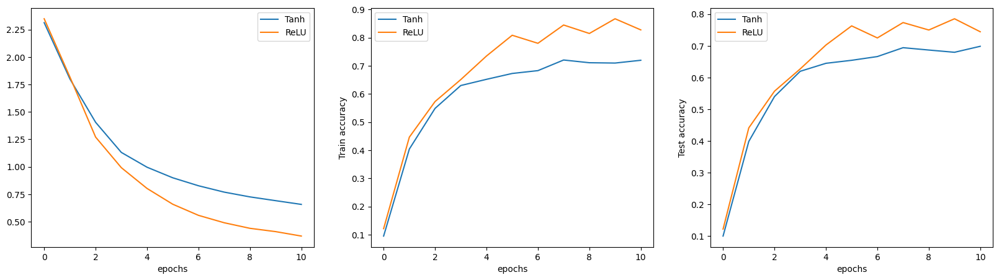

In [21]:
fig, (ax11,ax21,ax31) = plt.subplots(1,3, figsize = (20,5))


## Plot cross entropy loss
ax11.plot(range(len(tanh_loss)), tanh_loss, label = 'Tanh', color = 'C0')
ax11.plot(range(len(relu_loss)), relu_loss, label = 'ReLU', color = 'C1')
ax11.set_xlabel('epochs')
ax11.legend()

## Plot train acc
ax21.plot(range(len(tanh_train_acc)), [_.cpu() for _ in tanh_train_acc], label = 'Tanh', color = 'C0')
ax21.plot(range(len(relu_train_acc)), [_.cpu() for _ in relu_train_acc], label = 'ReLU', color = 'C1')
ax21.set_ylabel('Train accuracy')
ax21.set_xlabel('epochs')
ax21.legend()

## Plot test acc
ax31.plot(range(len(tanh_test_acc)), [_.cpu() for _ in tanh_test_acc], label = 'Tanh', color = 'C0')
ax31.plot(range(len(relu_test_acc)), [_.cpu() for _ in relu_test_acc], label = 'ReLU', color = 'C1')
ax31.set_ylabel('Test accuracy')
ax31.set_xlabel('epochs')
ax31.legend()

## 2.3 Remove Batch Normalization

##### Task

Train a resnet18 removing batch normalization for ten epochs. Use relu activation.

In [7]:
if assesment_draw_and_fill:
    code = """```python
torch.manual_seed(0)
device = 'cuda'

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = ...,
        activation = ...,  
        apply_bn = ...,
        link_function = ...,
        loss_function = ...,
)

model.to(device)

## ==================== ##
## Model Train and Eval ##
## ==================== ##
relu_nobn_loss, relu_nobn_train_acc, relu_nobn_test_acc = test_model(
    ...,
    epochs = ...,
    eval_each = ...,
    train_batch_size = ...,
    train_dataset = ...,
    test_dataset = ...
)
```"""

    display(Markdown(code))

```python
torch.manual_seed(0)
device = 'cuda'

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = ...,
        activation = ...,  
        apply_bn = ...,
        link_function = ...,
        loss_function = ...,
)

model.to(device)

## ==================== ##
## Model Train and Eval ##
## ==================== ##
relu_nobn_loss, relu_nobn_train_acc, relu_nobn_test_acc = test_model(
    ...,
    epochs = ...,
    eval_each = ...,
    train_batch_size = ...,
    train_dataset = ...,
    test_dataset = ...
)
```

In [7]:
torch.manual_seed(0)
device = 'cuda'

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = 10,
        activation = torch.relu,  
        apply_bn = False,
        link_function = torch.softmax,
        loss_function = nn.CrossEntropyLoss(),
)

model.to(device)

## ==================== ##
## Model Train and Eval ##
## ==================== ##
relu_nobn_loss, relu_nobn_train_acc, relu_nobn_test_acc = test_model(
    model,
    epochs = 10,
    eval_each = 1,
    train_batch_size = 100,
    train_dataset = train_dataset_cifar10,
    test_dataset = test_dataset_cifar10
)

On epoch 1 got loss 1.94620 with train accuracy 0.42026 and test accuracy 0.42040                                                                                                                       
On epoch 2 got loss 1.44819 with train accuracy 0.54442 and test accuracy 0.52800                                                                                                                       
On epoch 3 got loss 1.18750 with train accuracy 0.63834 and test accuracy 0.60560                                                                                                                       
On epoch 4 got loss 0.97987 with train accuracy 0.70952 and test accuracy 0.66470                                                                                                                       
On epoch 5 got loss 0.83996 with train accuracy 0.77696 and test accuracy 0.71480                                                                                                                   

##### Task

Plot loss, train_acc and test_acc comparing  the usage or not of batch normalization.

In [9]:
if assesment_draw_and_fill:
    code = """```python
fig, (ax11,ax21,ax31) = plt.subplots(1,3, figsize = (20,5))

## Plot cross entropy loss
ax11.plot(range(len(...)), ..., label = 'BN No', color = 'C0')
ax11.plot(range(len(...)), ..., label = 'BN yes', color = 'C1')
ax11.set_xlabel('epochs')
ax11.legend()

## Plot train acc
ax21.plot(range(len(...)), [_.cpu() for _ in ...], label = 'BN no', color = 'C0')
ax21.plot(range(len(...)), [_.cpu() for _ in ...], label = 'BN yes', color = 'C1')
ax21.set_ylabel('Train accuracy')
ax21.set_xlabel('epochs')
ax21.legend()

## Plot test acc
ax31.plot(range(len(...)), [_.cpu() for _ in ...], label = 'BN no', color = 'C0')
ax31.plot(range(len(...)), [_.cpu() for _ in ...], label = 'BN yes', color = 'C1')
ax31.set_ylabel('Test accuracy')
ax31.set_xlabel('epochs')
ax31.legend()
```
"""
    display(Markdown(code))

```python
fig, (ax11,ax21,ax31) = plt.subplots(1,3, figsize = (20,5))

## Plot cross entropy loss
ax11.plot(range(len(...)), ..., label = 'BN No', color = 'C0')
ax11.plot(range(len(...)), ..., label = 'BN yes', color = 'C1')
ax11.set_xlabel('epochs')
ax11.legend()

## Plot train acc
ax21.plot(range(len(...)), [_.cpu() for _ in ...], label = 'BN no', color = 'C0')
ax21.plot(range(len(...)), [_.cpu() for _ in ...], label = 'BN yes', color = 'C1')
ax21.set_ylabel('Train accuracy')
ax21.set_xlabel('epochs')
ax21.legend()

## Plot test acc
ax31.plot(range(len(...)), [_.cpu() for _ in ...], label = 'BN no', color = 'C0')
ax31.plot(range(len(...)), [_.cpu() for _ in ...], label = 'BN yes', color = 'C1')
ax31.set_ylabel('Test accuracy')
ax31.set_xlabel('epochs')
ax31.legend()
```


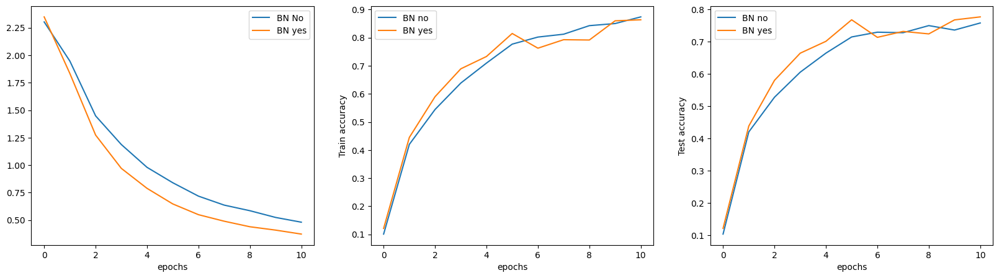

In [8]:
fig, (ax11,ax21,ax31) = plt.subplots(1,3, figsize = (20,5))

## Plot cross entropy loss
ax11.plot(range(len(relu_nobn_loss)), relu_nobn_loss, label = 'BN No', color = 'C0')
ax11.plot(range(len(relu_loss)), relu_loss, label = 'BN yes', color = 'C1')
ax11.set_xlabel('epochs')
ax11.legend()

## Plot train acc
ax21.plot(range(len(relu_nobn_train_acc)), [_.cpu() for _ in relu_nobn_train_acc], label = 'BN no', color = 'C0')
ax21.plot(range(len(relu_train_acc)), [_.cpu() for _ in relu_train_acc], label = 'BN yes', color = 'C1')
ax21.set_ylabel('Train accuracy')
ax21.set_xlabel('epochs')
ax21.legend()

## Plot test acc
ax31.plot(range(len(relu_nobn_test_acc)), [_.cpu() for _ in relu_nobn_test_acc], label = 'BN no', color = 'C0')
ax31.plot(range(len(relu_test_acc)), [_.cpu() for _ in relu_test_acc], label = 'BN yes', color = 'C1')
ax31.set_ylabel('Test accuracy')
ax31.set_xlabel('epochs')
ax31.legend()

## 2.4 Data Augmentation

One way to improve any machine learning model is to augment the dataset using plausible transformations with the data you are trying to model. For example, if you are modelling numbers, it seems reasonable to make the model learn over small translations or rotations of the different inputs. However, it will not make sense to train a model on rotations of 180 degrees, since that would imply we are expecting numbers written wrongly.

Why this should work? Well because it is expected that these small variations can appear over the test set, since, as humans, we implicitely perform this variations when writting. 

We could create variations of the images and save them to disk, but this will limit our capacity since we need big storage and we might miss some possible transformations. So it is better to do it on the fly, i.e, each time we sample a minibatch from the training set, we can apply different transformations. This implies randomness in the input and we already now randomness is good for a big neural net to avoid overfitting.

These transformations are only applied to the training data. The test data is kept as it is.

Torchvision allow us to do this through what are called torchvision transforms. There are plenty of them but you can also create your custom ones, as we saw in the Pytorch assesment.

##### Task

Train a resnet18 with relu and batch normalization, for 200 epochs. Evaluate each 10 epochs. Run the model on GPU and if possible in more than one at the same time.

In [9]:
torch.manual_seed(0)
device = 'cuda'

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = 10,
        activation = torch.relu,  
        apply_bn = True,
        link_function = torch.softmax,
        loss_function = nn.CrossEntropyLoss(),
)

model.to(device)

## ==================== ##
## Model Train and Eval ##
## ==================== ##
no_da_loss, no_da_train_acc, no_da_test_acc = test_model(
    model,
    epochs = 200,
    eval_each = 10,
    train_batch_size = 100,
    train_dataset = train_dataset_cifar10,
    test_dataset = test_dataset_cifar10
)

On epoch 1 got loss 1.83139 with train accuracy 0.46476 and test accuracy 0.45540                                                                                                                       
On epoch 2 got loss 1.28902                                                                                                                                                                             
On epoch 3 got loss 0.99379                                                                                                                                                                             
On epoch 4 got loss 0.81199                                                                                                                                                                             
On epoch 5 got loss 0.67095                                                                                                                                                                         

##### Task

Create cifar10 and cifar100 dataset with data augmentation transformations. The pipeline of transformations should be:

1. 32 Random crops with padding.
2. Random Horizontal flip
3. Convert to tensor
4. Normalize

In [11]:
if assesment_draw_and_fill:
    code = """```python
## =========================== ##
## Data Pipeline configuration ##
## =========================== ##

## Transformations for training
transform_train = transforms.Compose([
    ...,
    ...,
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

## Transformations for test
transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

# Train dataset
train_dataset_DA_cifar10 = torchvision.datasets.CIFAR10(...)

# Test dataset
test_dataset_DA_cifar10 = torchvision.datasets.CIFAR10(...)

# Train dataset
train_dataset_DA_cifar100 = torchvision.datasets.CIFAR100(...)

# Test dataset
test_dataset_DA_cifar100 = torchvision.datasets.CIFAR100(...)
```
"""
    display(Markdown(code))

```python
## =========================== ##
## Data Pipeline configuration ##
## =========================== ##

## Transformations for training
transform_train = transforms.Compose([
    ...,
    ...,
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

## Transformations for test
transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

# Train dataset
train_dataset_DA_cifar10 = torchvision.datasets.CIFAR10(...)

# Test dataset
test_dataset_DA_cifar10 = torchvision.datasets.CIFAR10(...)

# Train dataset
train_dataset_DA_cifar100 = torchvision.datasets.CIFAR100(...)

# Test dataset
test_dataset_DA_cifar100 = torchvision.datasets.CIFAR100(...)
```


In [12]:
## =========================== ##
## Data Pipeline configuration ##
## =========================== ##

## Transformations for training
transform_train = transforms.Compose([
    transforms.RandomCrop(32, padding=4),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

## Transformations for test
transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

# Train dataset
train_dataset_DA_cifar10 = torchvision.datasets.CIFAR10(root='/tmp/data', train=True, transform=transform_train, download=True)

# Test dataset
test_dataset_DA_cifar10 = torchvision.datasets.CIFAR10(root='/tmp/data', train=False, transform=transform_test, download=True)

# Train dataset
train_dataset_DA_cifar100 = torchvision.datasets.CIFAR100(root='/tmp/data', train=True, transform=transform_train, download=True)

# Test dataset
test_dataset_DA_cifar100 = torchvision.datasets.CIFAR100(root='/tmp/data', train=False, transform=transform_test, download=True)

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified


##### Task

Train the model now using data augmentation. Eval each 10 epochs. Save the model using:

```python
## save trained model for later
torch.save(model.state_dict(), 'model_weights_resnet18.pth')
```

In [13]:
if assesment_draw_and_fill:
    code = """```python
torch.manual_seed(0)
device = 'cuda'

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = ...,
        activation = ...,  
        apply_bn = ...,
        link_function = ...,
        loss_function = ...,
)

model.to(device)

## ==================== ##
## Model Train and Eval ##
## ==================== ##
yes_da_loss, yes_da_train_acc, yes_da_test_acc = test_model(
    ...,
    epochs = ...,
    eval_each = ...,
    train_batch_size = ...,
    train_dataset = ...,
    test_dataset = ...
)

## save trained model for later
torch.save(model.state_dict(), 'model_weights_resnet18.pth') 
```"""
    display(Markdown(code))

```python
torch.manual_seed(0)
device = 'cuda'

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = ...,
        activation = ...,  
        apply_bn = ...,
        link_function = ...,
        loss_function = ...,
)

model.to(device)

## ==================== ##
## Model Train and Eval ##
## ==================== ##
yes_da_loss, yes_da_train_acc, yes_da_test_acc = test_model(
    ...,
    epochs = ...,
    eval_each = ...,
    train_batch_size = ...,
    train_dataset = ...,
    test_dataset = ...
)

## save trained model for later
torch.save(model.state_dict(), 'model_weights_resnet18.pth') 
```

In [13]:
torch.manual_seed(0)
device = 'cuda'

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = 10,
        activation = torch.relu,  
        apply_bn = True,
        link_function = torch.softmax,
        loss_function = nn.CrossEntropyLoss(),
)

model.to(device)

## ==================== ##
## Model Train and Eval ##
## ==================== ##
yes_da_loss, yes_da_train_acc, yes_da_test_acc = test_model(
    model,
    epochs = 200,
    eval_each = 10,
    train_batch_size = 100,
    train_dataset = train_dataset_DA_cifar10,
    test_dataset = test_dataset_DA_cifar10
)

## save trained model for later
torch.save(model.state_dict(), 'model_weights_resnet18.pth')

On epoch 1 got loss 1.83045 with train accuracy 0.45796 and test accuracy 0.47470                                                                                                                       
On epoch 2 got loss 1.36130                                                                                                                                                                             
On epoch 3 got loss 1.08743                                                                                                                                                                             
On epoch 4 got loss 0.92890                                                                                                                                                                             
On epoch 5 got loss 0.80595                                                                                                                                                                         

##### Task

Plot and compare loss, training error and test error of the model trained with and withouth data augmentation.

In [14]:
if assesment_draw_and_fill:
    code = """```python
fig, (ax11,ax21,ax31) = plt.subplots(1,3, figsize = (20,5))

## Plot cross entropy loss
ax11.plot(range(len(...)), ..., label = 'Yes DA', color = 'C0')
ax11.plot(range(len(...)), ..., label = 'No DA', color = 'C1')
ax11.set_xlabel('epochs')
ax11.legend()

## Plot train acc
ax21.plot(range(len(...)), [_.cpu() for _ in ...], label = 'Yes DA', color = 'C0')
ax21.plot(range(len(...)), [_.cpu() for _ in ...], label = 'No DA', color = 'C1')
ax21.set_ylabel('Train accuracy')
ax21.set_xlabel('epochs')
ax21.legend()

## Plot test acc
ax31.plot(range(len(...)), [_.cpu() for _ in ...], label = 'Yes DA', color = 'C0')
ax31.plot(range(len(...)), [_.cpu() for _ in ...], label = 'No DA', color = 'C1')
ax31.set_ylabel('Test accuracy')
ax31.set_xlabel('epochs')
ax31.legend()
```"""

    display(Markdown(code))

```python
fig, (ax11,ax21,ax31) = plt.subplots(1,3, figsize = (20,5))

## Plot cross entropy loss
ax11.plot(range(len(...)), ..., label = 'Yes DA', color = 'C0')
ax11.plot(range(len(...)), ..., label = 'No DA', color = 'C1')
ax11.set_xlabel('epochs')
ax11.legend()

## Plot train acc
ax21.plot(range(len(...)), [_.cpu() for _ in ...], label = 'Yes DA', color = 'C0')
ax21.plot(range(len(...)), [_.cpu() for _ in ...], label = 'No DA', color = 'C1')
ax21.set_ylabel('Train accuracy')
ax21.set_xlabel('epochs')
ax21.legend()

## Plot test acc
ax31.plot(range(len(...)), [_.cpu() for _ in ...], label = 'Yes DA', color = 'C0')
ax31.plot(range(len(...)), [_.cpu() for _ in ...], label = 'No DA', color = 'C1')
ax31.set_ylabel('Test accuracy')
ax31.set_xlabel('epochs')
ax31.legend()
```

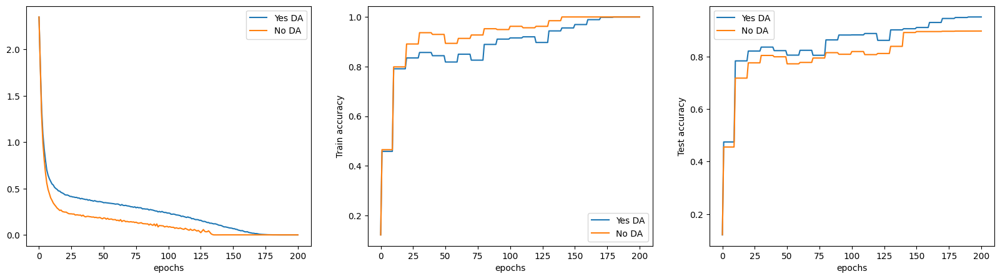

In [14]:
fig, (ax11,ax21,ax31) = plt.subplots(1,3, figsize = (20,5))


## Plot cross entropy loss
ax11.plot(range(len(yes_da_loss)), yes_da_loss, label = 'Yes DA', color = 'C0')
ax11.plot(range(len(no_da_loss)), no_da_loss, label = 'No DA', color = 'C1')
ax11.set_xlabel('epochs')
ax11.legend()

## Plot train acc
ax21.plot(range(len(yes_da_train_acc)), [_.cpu() for _ in yes_da_train_acc], label = 'Yes DA', color = 'C0')
ax21.plot(range(len(no_da_train_acc)), [_.cpu() for _ in no_da_train_acc], label = 'No DA', color = 'C1')
ax21.set_ylabel('Train accuracy')
ax21.set_xlabel('epochs')
ax21.legend()

## Plot test acc
ax31.plot(range(len(yes_da_test_acc)), [_.cpu() for _ in yes_da_test_acc], label = 'Yes DA', color = 'C0')
ax31.plot(range(len(no_da_test_acc)), [_.cpu() for _ in no_da_test_acc], label = 'No DA', color = 'C1')
ax31.set_ylabel('Test accuracy')
ax31.set_xlabel('epochs')
ax31.legend()

## 2.5 Visualizing Kernel Mappings  

Let's visualize the features learnt by the model. To do so, we will get one image, forward it thourgh the model and plot the result of the convolution of each filter with the input, at each layer, as images. 

##### Task

Create a ResNet model instance and load the saved weights into this instance. You can do that through:

```python
model.load_state_dict(torch.load('model_weights_resnet18.pth', weights_only=True, map_location = torch.device("cpu")))
```

In [17]:
if assesment_draw_and_fill:
    code = """```python
torch.manual_seed(0)
device = 'cpu'

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = ...,
        activation = ...,  
        apply_bn = ...,
        drop_prob = ...,
        link_function = ...,
        loss_function = ...,
)

model.to(device)

model.load_state_dict(torch.load('model_weights_resnet18.pth', weights_only=True, map_location = torch.device("cpu")))
```
"""
    display(Markdown(code))

```python
torch.manual_seed(0)
device = 'cpu'

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = ...,
        activation = ...,  
        apply_bn = ...,
        drop_prob = ...,
        link_function = ...,
        loss_function = ...,
)

model.to(device)

model.load_state_dict(torch.load('model_weights_resnet18.pth', weights_only=True, map_location = torch.device("cpu")))
```


In [6]:
torch.manual_seed(0)
device = 'cpu'

## ============== ##
## Model Creation ##
## ============== ##

model = ResNet18(
        dim_out = 10,
        activation = torch.relu,  
        apply_bn = True,
        drop_prob = 0.0,
        link_function = torch.softmax,
        loss_function = nn.CrossEntropyLoss(),
)

model.to(device)

model.load_state_dict(torch.load('model_weights_resnet18.pth', weights_only=True, map_location = torch.device("cpu")))

<All keys matched successfully>

##### Task

Create a dataloader using the training cifar10 dataset withouth data augmentation. Use shuffle False so that upon iteration you always receive the same images. Use a batch size of $30$ and obtain the feature maps of one of this image indices from the batch:  $4, 6, 7, 18$

In [18]:
if assesment_draw_and_fill:
    code = """```python
id_ims = ... # 4, 6, 7, 18

train_loader = torch.utils.data.DataLoader(..., batch_size=..., shuffle=...)
with torch.no_grad():
    for x, t in train_loader:
        feat_maps = model.get_feature_maps(x[...].unsqueeze(dim=0))
        break
```
"""
    display(Markdown(code))

```python
id_ims = ... # 4, 6, 7, 18

train_loader = torch.utils.data.DataLoader(..., batch_size=..., shuffle=...)
with torch.no_grad():
    for x, t in train_loader:
        feat_maps = model.get_feature_maps(x[...].unsqueeze(dim=0))
        break
```


In [68]:
id_ims = 18 # 4, 6, 7, 18

train_loader = torch.utils.data.DataLoader(train_dataset_cifar10, batch_size=30, shuffle=False)
with torch.no_grad():
    for x, t in train_loader:
        feat_maps = model.get_feature_maps(x[id_ims].unsqueeze(dim=0))
        break

##### Task

Iterate over the extracted feature maps and plot them in a grid of images, one image per layer.

In [19]:
if assesment_draw_and_fill:
    code = """```python
    
def find_factors(N):
    sqrt_N = int(np.sqrt(N)) 
    for A in range(sqrt_N, 0, -1):
        if N % A == 0:  
            B = N // A
            return A, B  

for ..., ... in feat_maps.items():
    
    grid_img = make_grid(..., scale_each = True, normalize = True)
    nrows, ncols = find_factors(grid_img.shape[0])
    
    fig, axs = plt.subplots(ncols = ..., nrows = ..., figsize = (30,30))
    for r in range(nrows):
        for c in range(ncols):
            img = grid_img[r*nrows + c]
            img = img.detach()
            axs[r, c].imshow(..., vmin = 0.0, vmax = 1.0)
            axs[r, c].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])
    fig.suptitle(f'{layer_id}', fontsize = 60)

```
"""

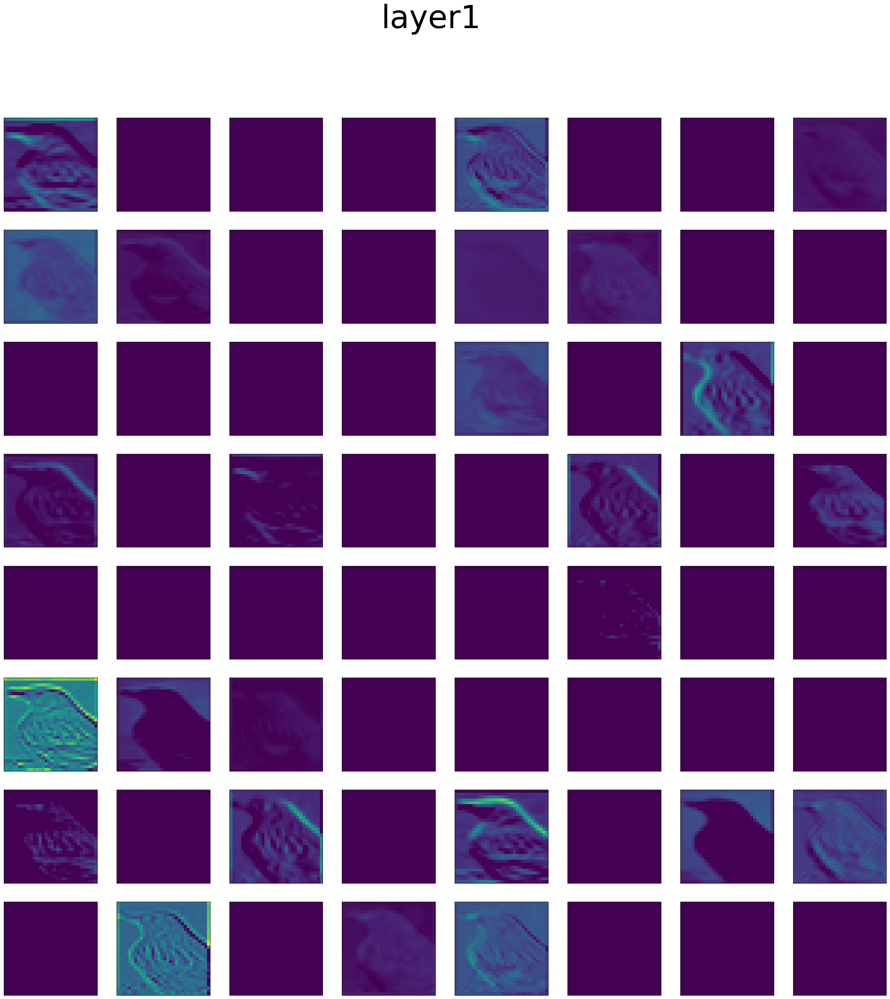

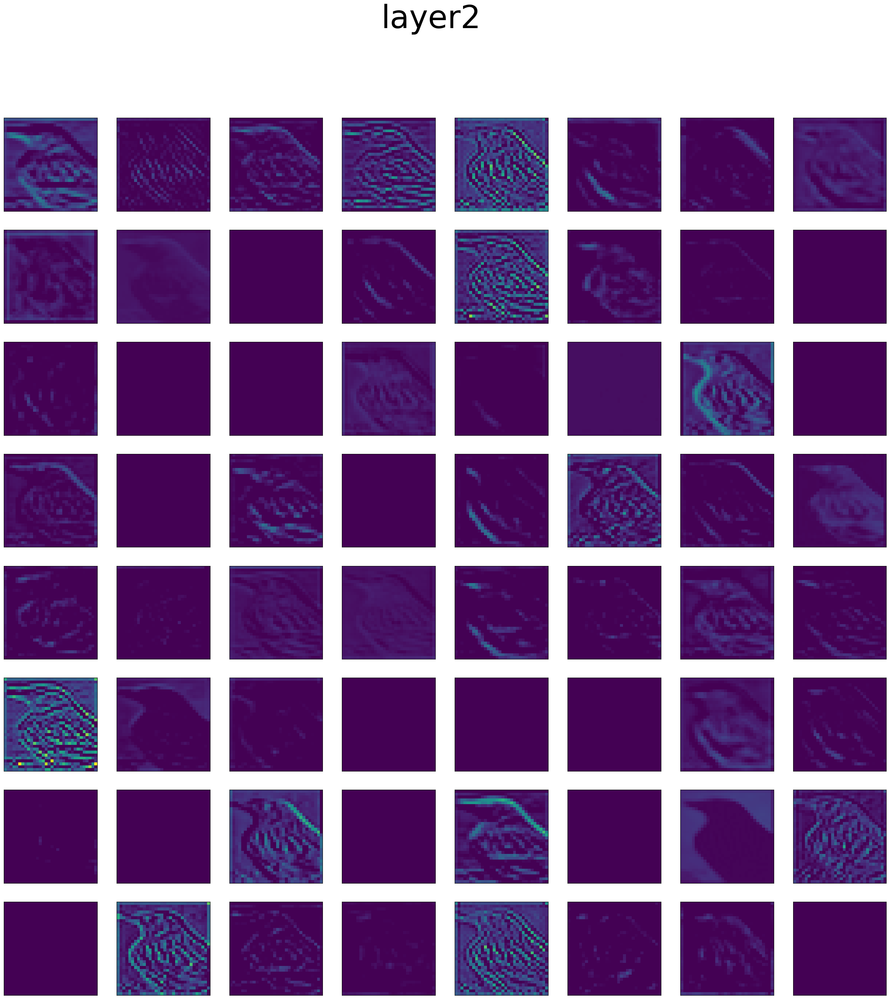

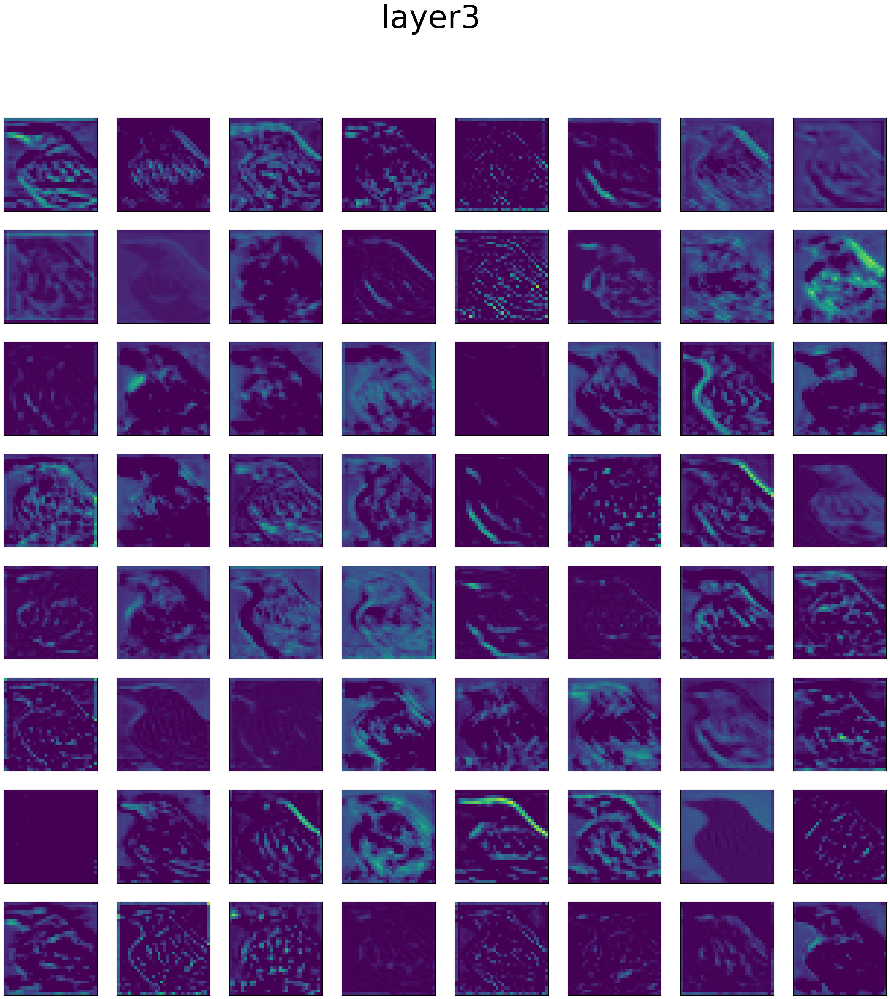

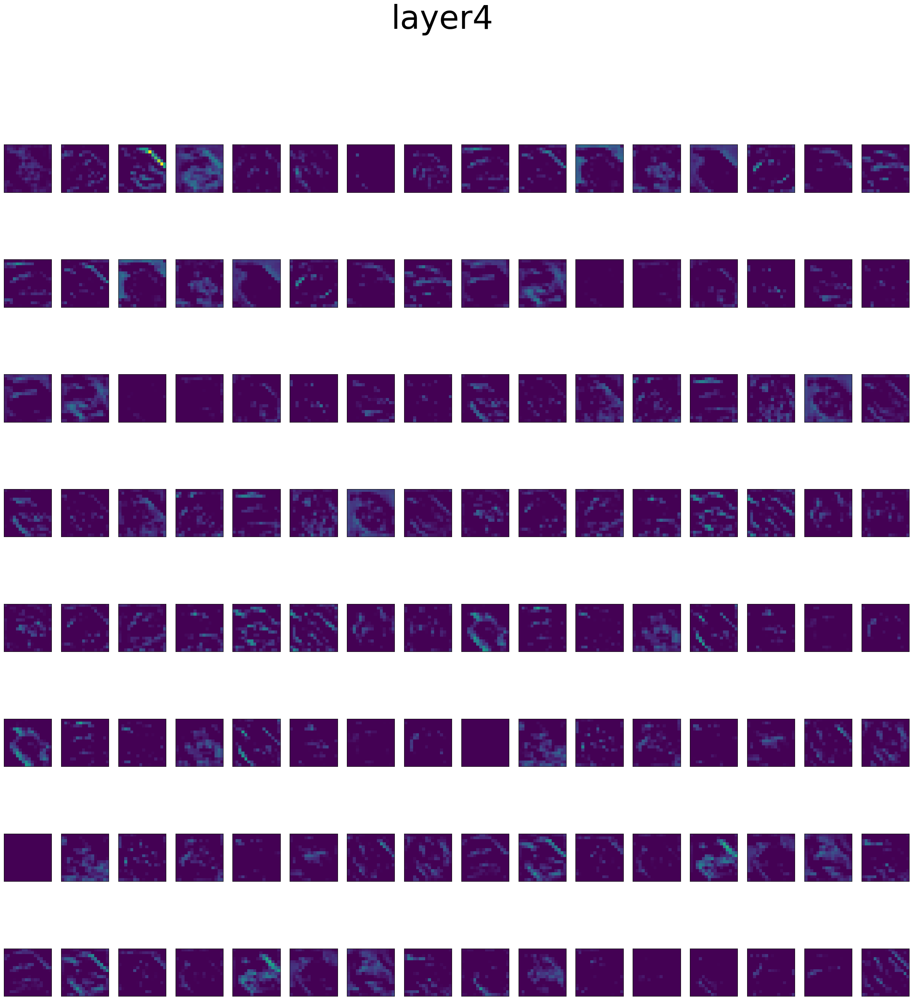

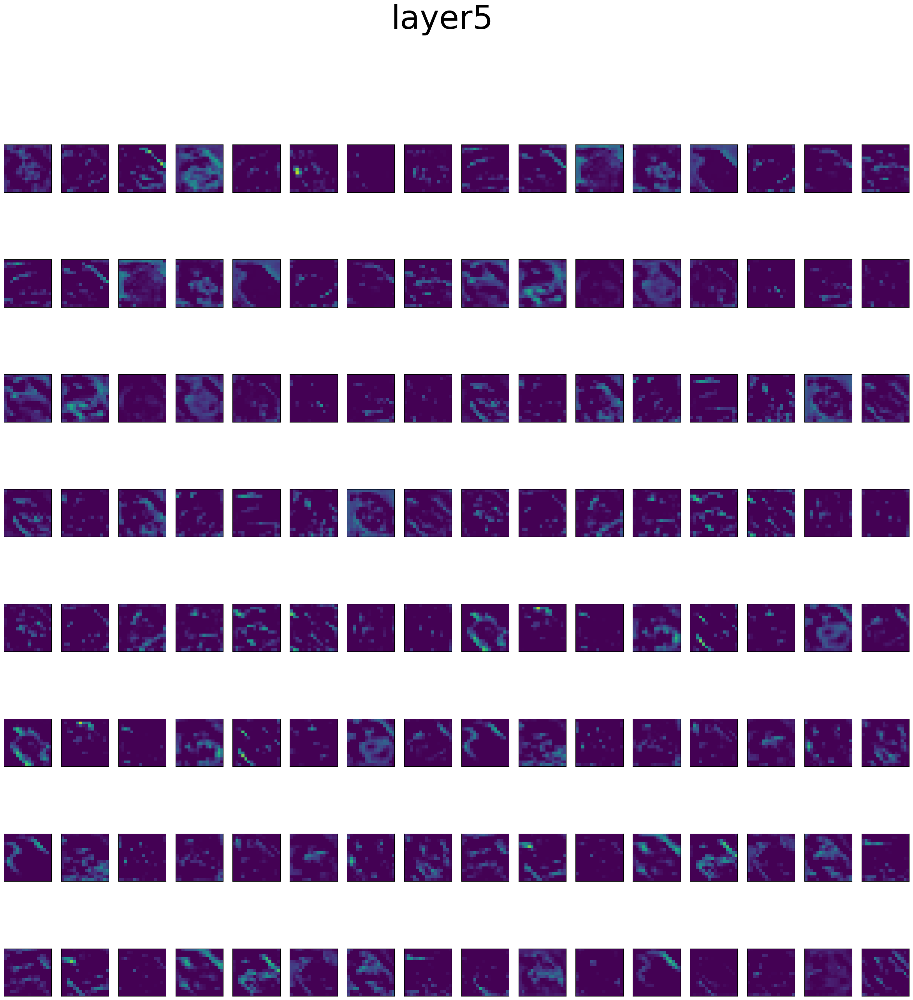

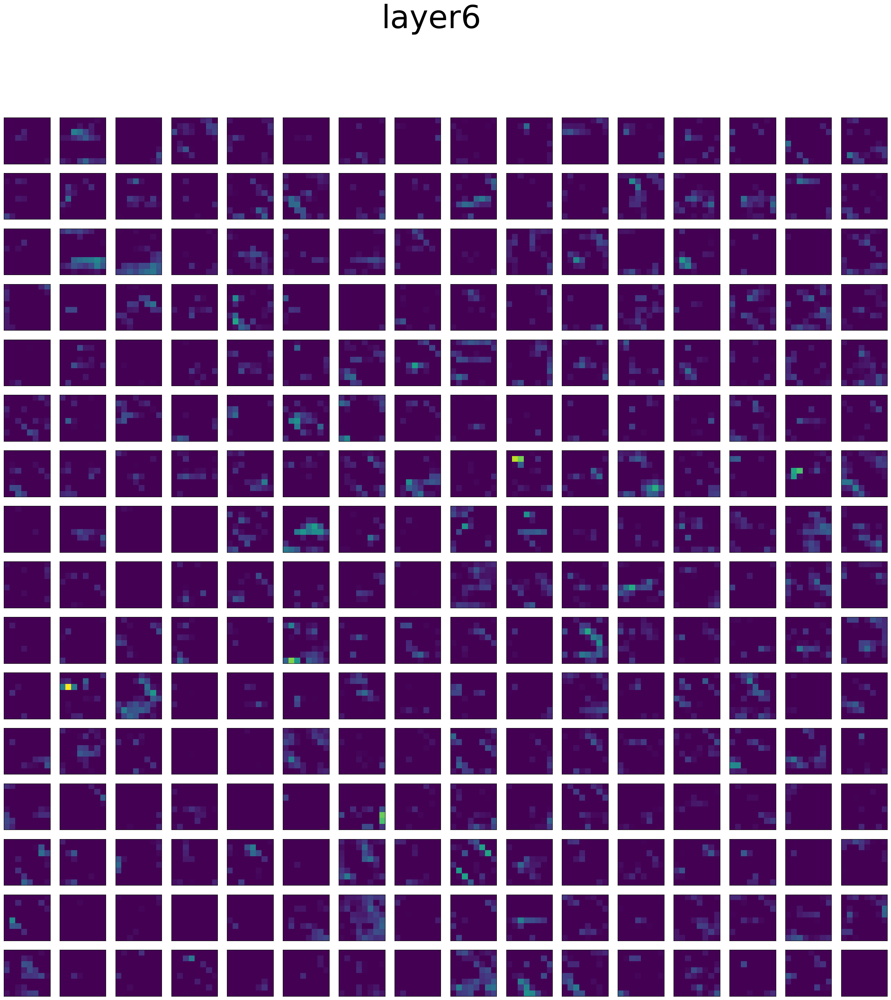

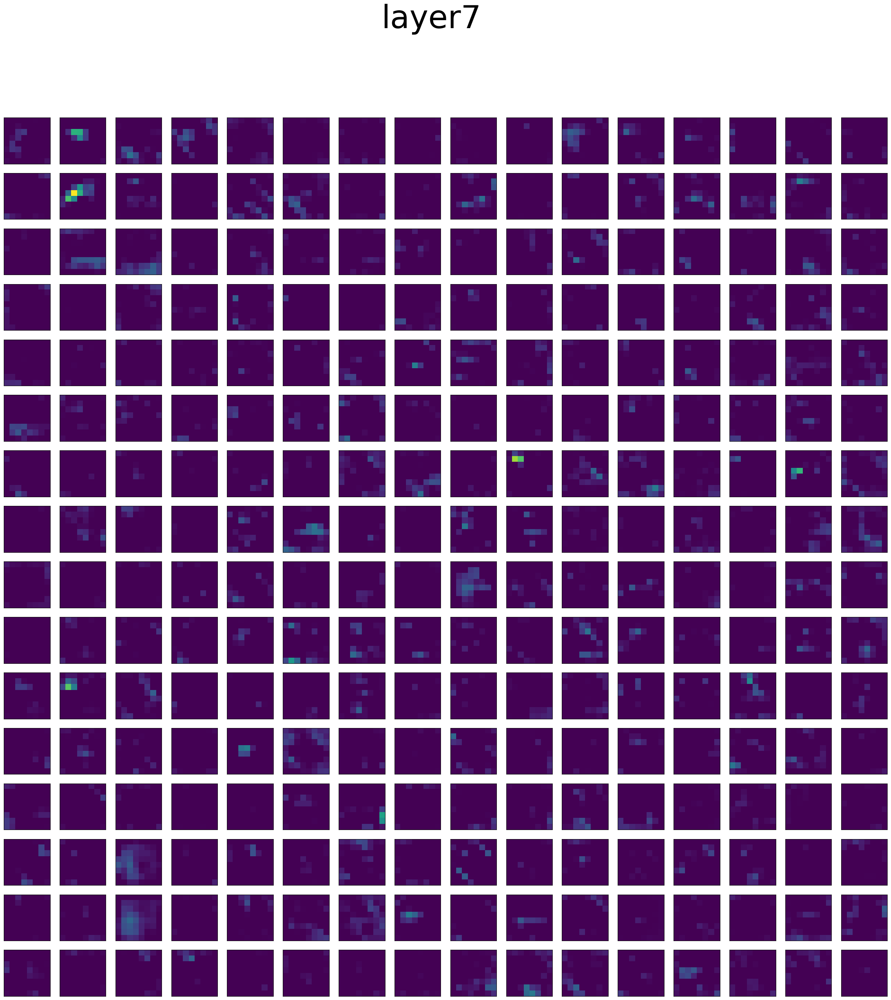

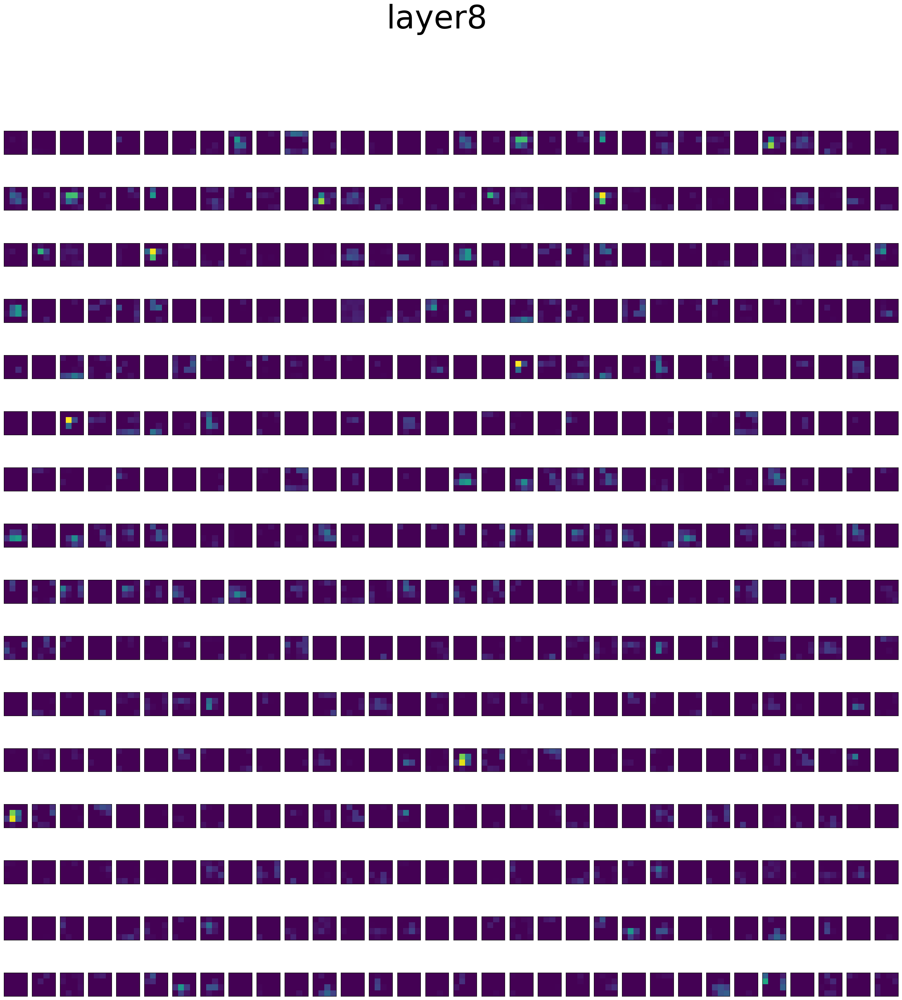

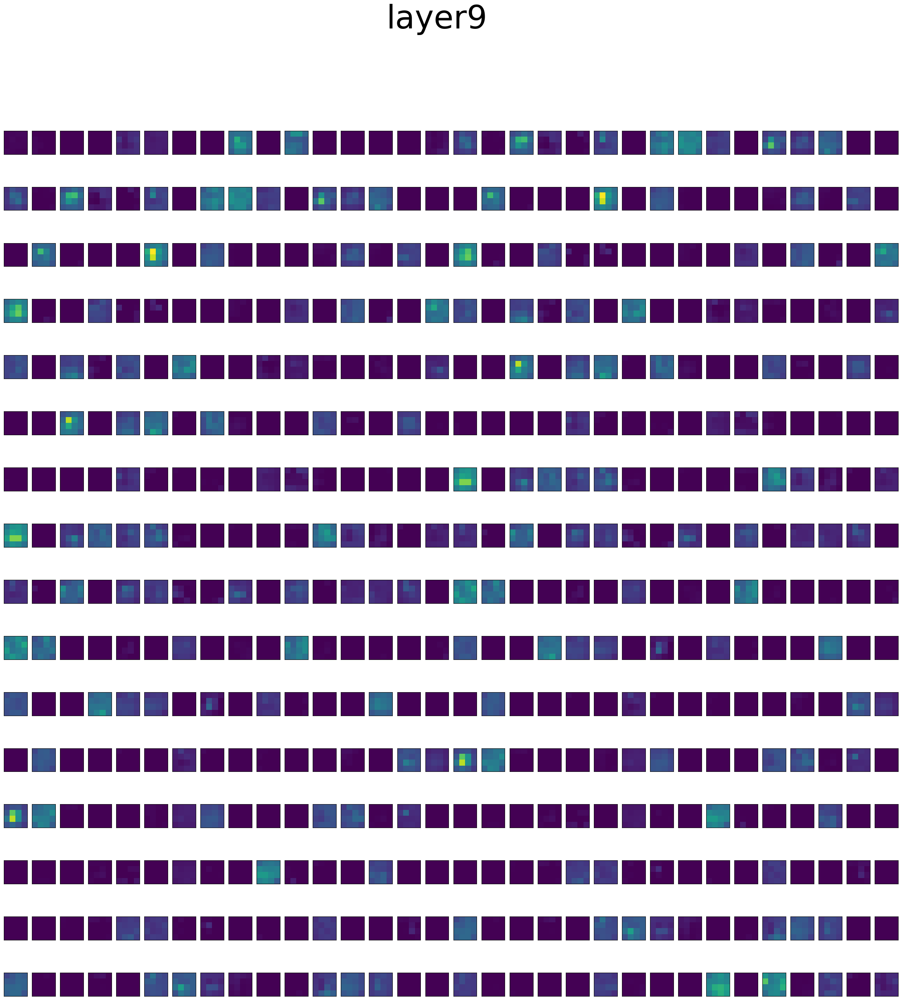

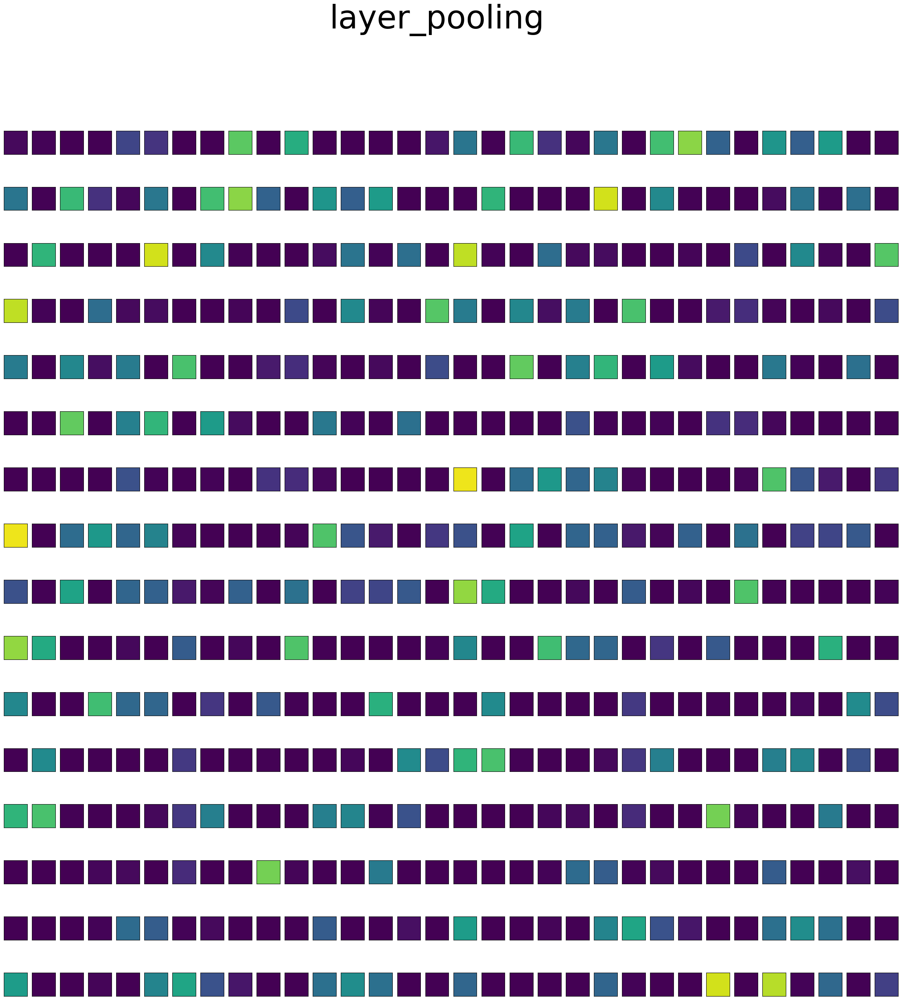

In [69]:
def find_factors(N):
    sqrt_N = int(np.sqrt(N)) 
    for A in range(sqrt_N, 0, -1):
        if N % A == 0:  
            B = N // A
            return A, B  

for layer_id, maps in feat_maps.items():
    
    grid_img = make_grid(maps, scale_each = True, normalize = True)
    nrows, ncols = find_factors(grid_img.shape[0])
    
    fig, axs = plt.subplots(ncols = ncols, nrows = nrows, figsize = (30,30))
    for r in range(nrows):
        for c in range(ncols):
            img = grid_img[r*nrows + c]
            img = img.detach()
            axs[r, c].imshow(img, vmin = 0.0, vmax = 1.0)
            axs[r, c].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])
    fig.suptitle(f'{layer_id}', fontsize = 60)

## 2.6 Remove Residual Connections

## 2.7 Add Dropout

## 2.8 Train model on cifar100